# Football

In this exaample, we use the 'football' dataset to predict the outcomes of games between various teams. You can download the Jupyter Notebook of the study <a href="football.ipynb">here</a>.

<ul class="ul_content">
    <li><b>date: </b>Date of the game</li>
    <li><b>home_team: </b>Home Team</li>
    <li><b>home_score: </b>Home Team number of goals</li>
    <li><b>away_team: </b>Away Team</li>
    <li><b>away_score: </b>Away Team number of goals</li>
    <li><b>tournament: </b>Game Type (World Cup, Friendly...)</li>
    <li><b>city: </b>City where the game took place</li>
    <li><b>country: </b>Country where the game took place</li>
    <li><b>neutral: </b>If the event took place to a neutral location</li>
</ul>

We will follow the data science cycle (Data Exploration - Data Preparation - Data Modeling - Model Evaluation - Model Deployment) to solve this problem.

## Initialization

This example uses the following version of VerticaPy:

In [1]:
import verticapy as vp
vp.__version__

'0.9.0'

Connect to Vertica. This example uses an existing connection called "VerticaDSN." For details on how to create a connection, use see the <a href="../../connection.php">connection tutorial</a>.

In [2]:
vp.connect("VerticaDSN")

Let's create a Virtual DataFrame of the dataset. The dataset is available <a href="../../data/football.csv">here</a>.

,📅dateDate,Abchome_teamVarchar(64),Abcaway_teamVarchar(64),123home_scoreInt,123away_scoreInt,AbctournamentVarchar(84),AbccityVarchar(56),AbccountryVarchar(64),010neutralBoolean
1,1872-11-30,Scotland,England,0,0,Friendly,Glasgow,Scotland,❌
2,1873-03-08,England,Scotland,4,2,Friendly,London,England,❌
3,1874-03-07,Scotland,England,2,1,Friendly,Glasgow,Scotland,❌
4,1875-03-06,England,Scotland,2,2,Friendly,London,England,❌
5,1876-03-04,Scotland,England,3,0,Friendly,Glasgow,Scotland,❌

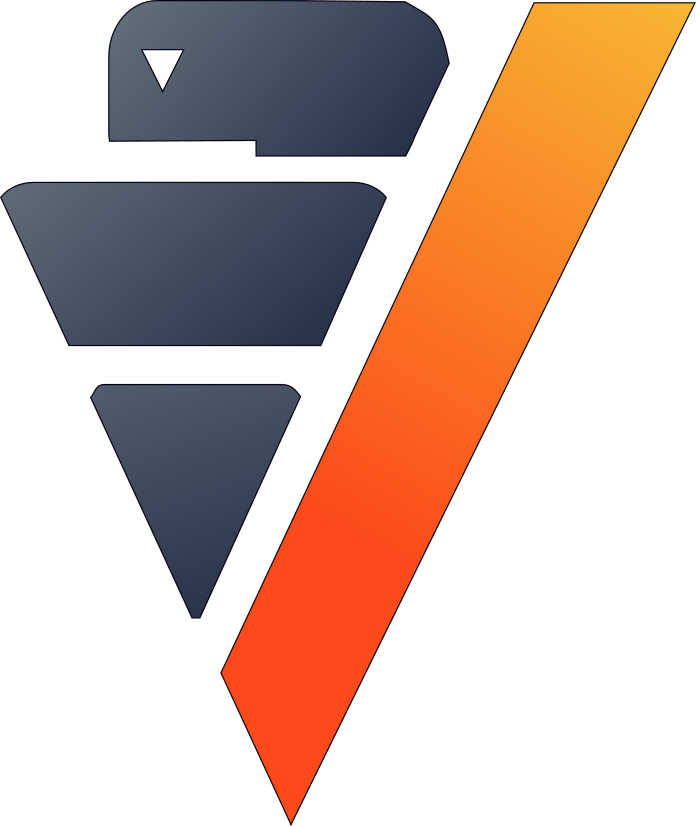

In [9]:
football = vp.read_csv("data/football.csv")
football.head(5)

## Data Exploration

Let's explore the data by displaying descriptive statistics of all the columns.

,value
name,"""date"""
dtype,date
count,41586
min,1872-11-30
max,2020-02-01

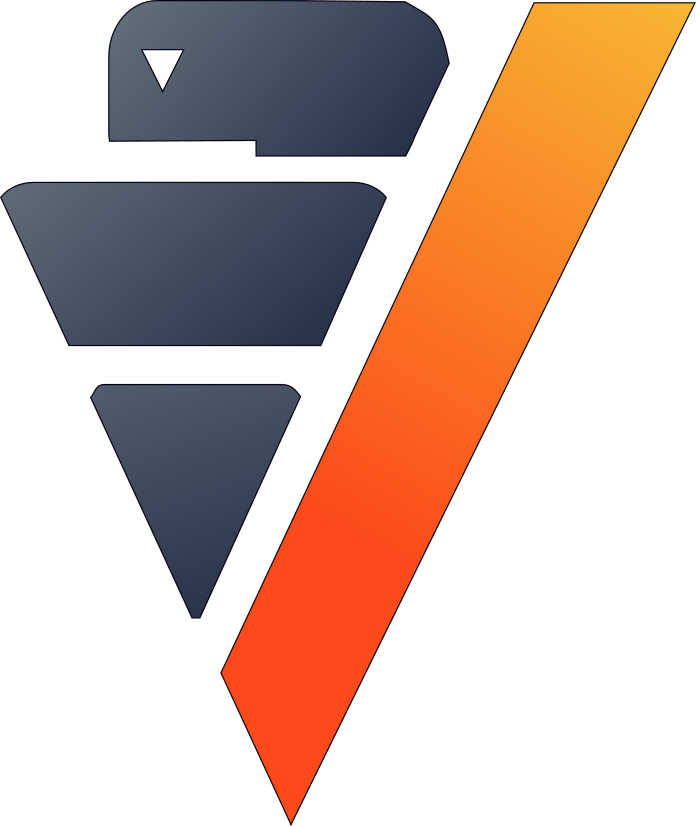

In [4]:
football["date"].describe()

The dataset includes a total of 41,586 games, which take place between 1872 and 2020. Let's look at our game types and teams.

,value
,"""tournament"""
,varchar(84)
,112.0
,41586.0
,17029
,10630
,7236
,2582
,1672
,900

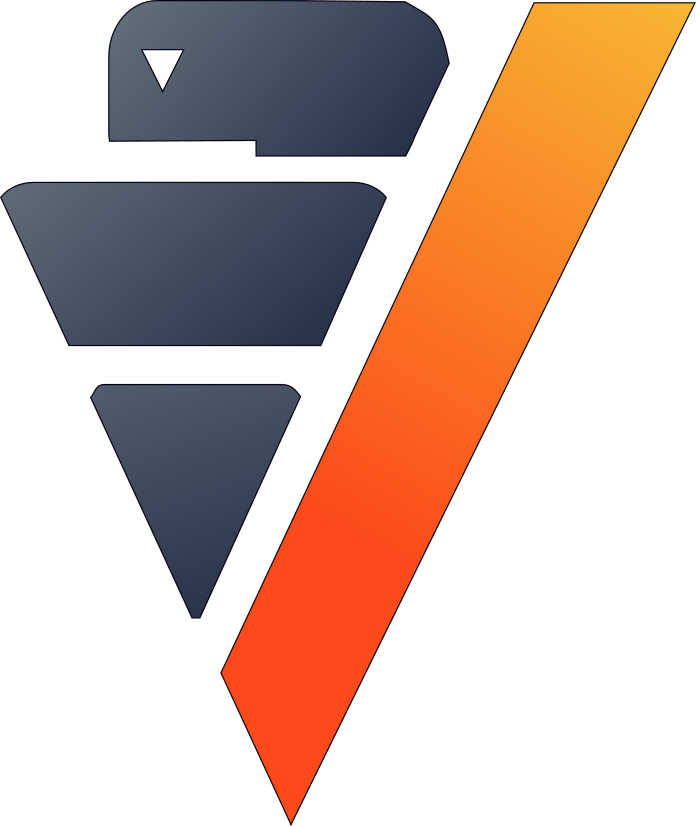

In [5]:
football["tournament"].describe()

Different types of tournaments took place (FIFA World Cup, UEFA Euro, etc.) aand most of the games in our data are friendlies or qualifiers for international tournaments.

,count,mean,std,min,approx_25%,approx_50%,approx_75%,max
"""home_score""",41586,1.74575578319628,1.75378034047699,0.0,1.0,1.0,2.0,31.0
"""away_score""",41586,1.18758716875872,1.40532346833589,0.0,0.0,1.0,2.0,21.0
"""neutral""",41586,0.247246669552252,0.431416538275649,0.0,0.0,0.0,0.0,1.0

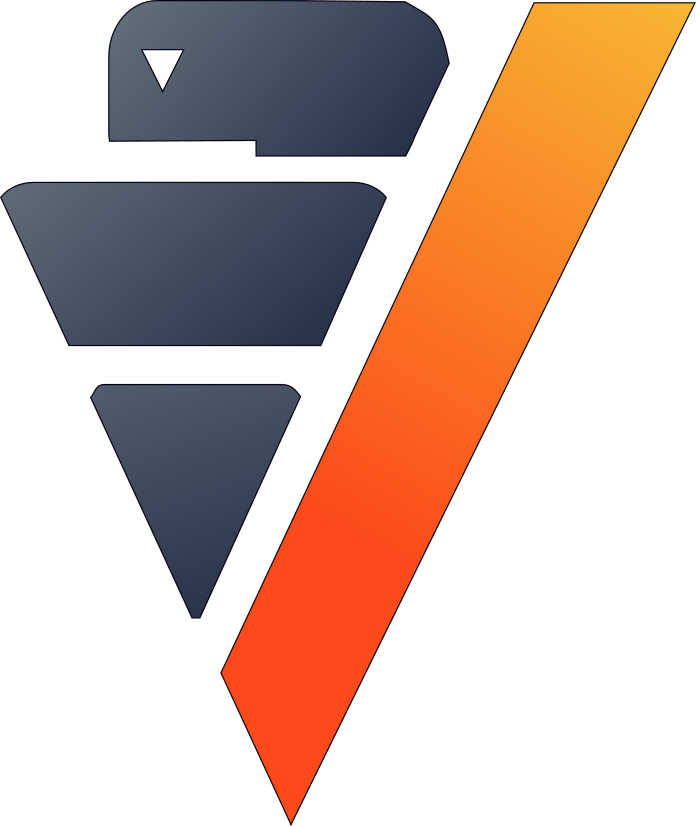

,dtype,count,top,top_percent
"""date""",date,41586,2012-02-29,0.159
"""home_team""",varchar(64),41586,Brazil,1.366
"""away_team""",varchar(64),41586,Uruguay,1.301
"""home_score""",int,41586,1,29.57
"""away_score""",int,41586,0,37.135
"""tournament""",varchar(84),41586,Friendly,40.949
"""city""",varchar(56),41586,Kuala Lumpur,1.416
"""country""",varchar(64),41586,United States,2.787
"""neutral""",boolean,41586,❌,75.275

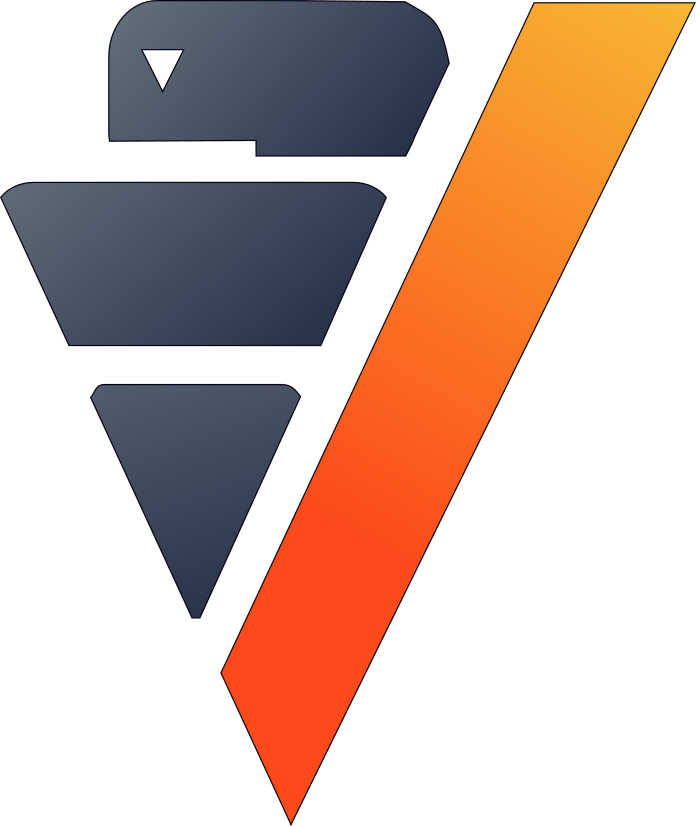

In [6]:
display(football.describe())
football.describe(method = "categorical")

The dataset includes 308 national teams. For most of the games, the home team scores better than the away team. Since some games take place in a neutral location, we can ensure this hypothesis using the variable 'neutral.' Notice also that the number of goals per match is pretty low (median of 1 for both away and home teams).

<b>Goal</b>

Our goal for the study will be to predict the outcomes of games after 2015.

Before doing the study, we can notice that some teams names have changed over time. We need to change the old names by the new names otherwise it will add too much bias in the data.

In [10]:
for team in ["home_team", "away_team"]:
    football[team].decode('German DR', 'Germany',
                          'Czechoslovakia', 'Czech Republic',
                          'Yugoslavia', 'Serbia',
                          'Yemen DPR', 'Yemen',
                          football[team])

Let's just consider teams that have played more than five home and away games.

177 elements were filtered


,📅dateDate,123home_scoreInt,Abchome_teamVarchar(64),AbctournamentVarchar(84),Abcaway_teamVarchar(64),123away_scoreInt,010neutralBoolean,AbccountryVarchar(64),AbccityVarchar(56)
1,1872-11-30,0,Scotland,Friendly,England,0,❌,Scotland,Glasgow
2,1873-03-08,4,England,Friendly,Scotland,2,❌,England,London
3,1874-03-07,2,Scotland,Friendly,England,1,❌,Scotland,Glasgow
4,1875-03-06,2,England,Friendly,Scotland,2,❌,England,London
5,1876-03-04,3,Scotland,Friendly,England,0,❌,Scotland,Glasgow
6,1876-03-25,4,Scotland,Friendly,Wales,0,❌,Scotland,Glasgow
7,1877-03-03,1,England,Friendly,Scotland,3,❌,England,London
8,1877-03-05,0,Wales,Friendly,Scotland,2,❌,Wales,Wrexham
9,1878-03-02,7,Scotland,Friendly,England,2,❌,Scotland,Glasgow
10,1878-03-23,9,Scotland,Friendly,Wales,0,❌,Scotland,Glasgow

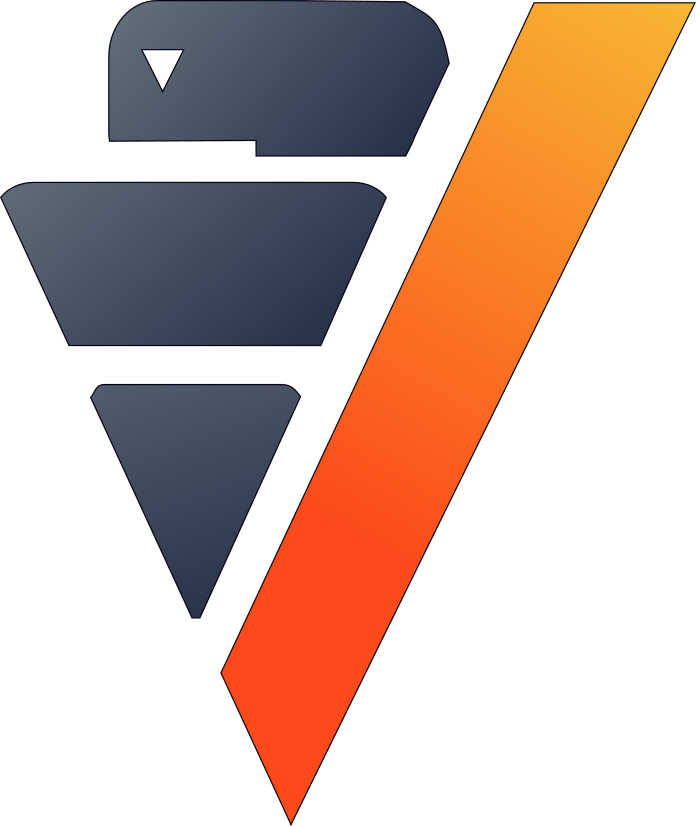

In [11]:
football["cnt_games_1"] = "COUNT(*) OVER (PARTITION BY home_team)"
football["cnt_games_2"] = "COUNT(*) OVER (PARTITION BY away_team)"
football.filter((football["cnt_games_2"] > 5) & (football["cnt_games_1"] > 5))
vp.drop("football_clean", relation_type = "table")
football.to_db(name = "football_clean",
               usecols = ["date", 
                          "home_score", 
                          "home_team", 
                          "tournament", 
                          "away_team", 
                          "away_score", 
                          "neutral", 
                          "country",
                          "city"],
               relation_type = "table",
               inplace = True)

A lot of things could influence the outcome of a game. Since we only have access to the score, teams, and type of game, we can't consider external factors like, weather or temperature, which would otherwise help our prediction.

To create a good model using this dataset, we could compute each team's key performance indicator (KPI), ranking (clusters computed using the number of games in important tournaments like the World Cup, the percentage of victory...), shape (moving windows using the last games information), and other factors.

Here's our plan:

<ul class="ul_content">
    <li>Identify cup winners</li>
    <li>Rank the teams with clustering</li>
    <li>Compute teams' KPIs</li>
    <li>Create a machine learning model</li>
</ul>

## Data Preparation for Clustering

To create clusters, we need to find which teams are the winners of main tournaments (mainly the World Cups and Continental Cups). Since all tournaments took place the same year, we could partition by tournament and year to identify the last game of the tournament.

We'll ignore ties for our analysis since there's no way to determine a winner.

### Cup Winner

Let's start by creating the feature 'winner' to indicate the winner of a game.

3884 elements were filtered


,📅dateDate,123home_scoreInt,Abchome_teamVarchar(64),AbctournamentVarchar(84),Abcaway_teamVarchar(64),123away_scoreInt,010neutralBoolean,AbccountryVarchar(64),AbccityVarchar(56),AbcwinnerVarchar(64)
1,1872-11-30,0,Scotland,Friendly,England,0,❌,Scotland,Glasgow,[null]
2,1873-03-08,4,England,Friendly,Scotland,2,❌,England,London,England
3,1874-03-07,2,Scotland,Friendly,England,1,❌,Scotland,Glasgow,Scotland
4,1875-03-06,2,England,Friendly,Scotland,2,❌,England,London,[null]
5,1876-03-04,3,Scotland,Friendly,England,0,❌,Scotland,Glasgow,Scotland
6,1876-03-25,4,Scotland,Friendly,Wales,0,❌,Scotland,Glasgow,Scotland
7,1877-03-03,1,England,Friendly,Scotland,3,❌,England,London,Scotland
8,1877-03-05,0,Wales,Friendly,Scotland,2,❌,Wales,Wrexham,Scotland
9,1878-03-02,7,Scotland,Friendly,England,2,❌,Scotland,Glasgow,Scotland
10,1878-03-23,9,Scotland,Friendly,Wales,0,❌,Scotland,Glasgow,Scotland

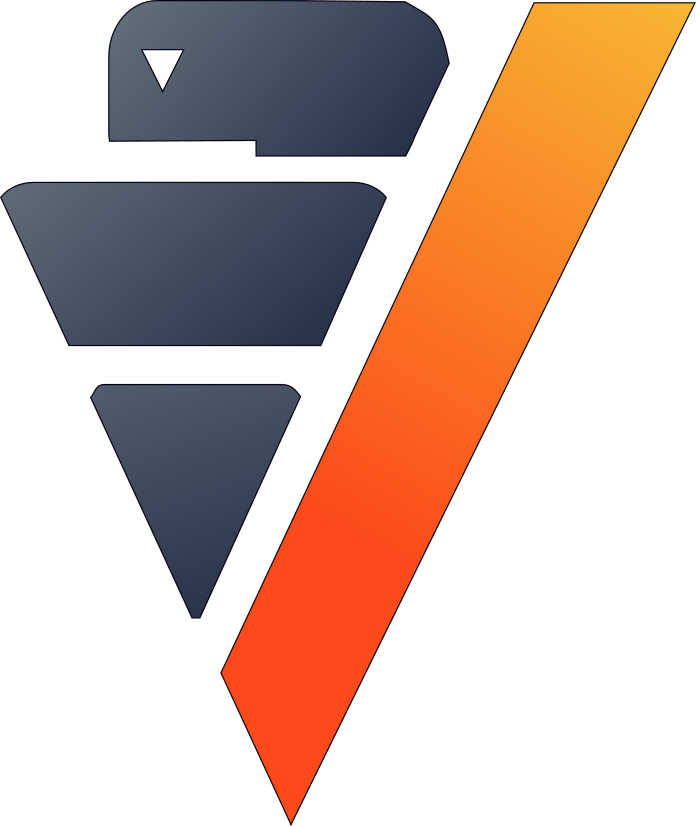

In [13]:
import verticapy.stats as st
football.filter(st.year(football["date"]) <= 2015)
football.case_when("winner",
                   football["home_score"] > football["away_score"], football["home_team"],
                   football["home_score"] < football["away_score"], football["away_team"],
                   None)

Let's analyze the last game of each tournament.

,📅dateDate,123home_scoreInt,Abchome_teamVarchar(64),AbctournamentVarchar(84),Abcaway_teamVarchar(64),123away_scoreInt,010neutralBoolean,AbccountryVarchar(64),AbccityVarchar(56),AbcwinnerVarchar(64),123yearInteger,123order_tournamentInteger
1,2010-10-31,3,Aruba,ABCS Tournament,Bonaire,3,✅,Curaçao,Willemstad,[null],2010,1
2,2010-10-31,2,Curaçao,ABCS Tournament,Suriname,2,❌,Curaçao,Willemstad,[null],2010,2
3,2010-10-29,4,Suriname,ABCS Tournament,Bonaire,2,✅,Curaçao,Willemstad,Suriname,2010,3
4,2010-10-29,3,Curaçao,ABCS Tournament,Aruba,0,❌,Curaçao,Willemstad,Curaçao,2010,4
5,2011-12-04,2,Suriname,ABCS Tournament,Curaçao,0,❌,Suriname,Paramaribo,Suriname,2011,1
6,2011-12-04,2,Bonaire,ABCS Tournament,Aruba,2,✅,Suriname,Paramaribo,[null],2011,2
7,2011-12-02,1,Curaçao,ABCS Tournament,Bonaire,3,✅,Suriname,Paramaribo,Bonaire,2011,3
8,2011-12-02,0,Suriname,ABCS Tournament,Aruba,0,❌,Suriname,Paramaribo,[null],2011,4
9,2012-07-15,2,Bonaire,ABCS Tournament,Curaçao,9,✅,Aruba,Oranjestad,Curaçao,2012,1
10,2012-07-15,1,Aruba,ABCS Tournament,Suriname,0,❌,Aruba,Oranjestad,Aruba,2012,2

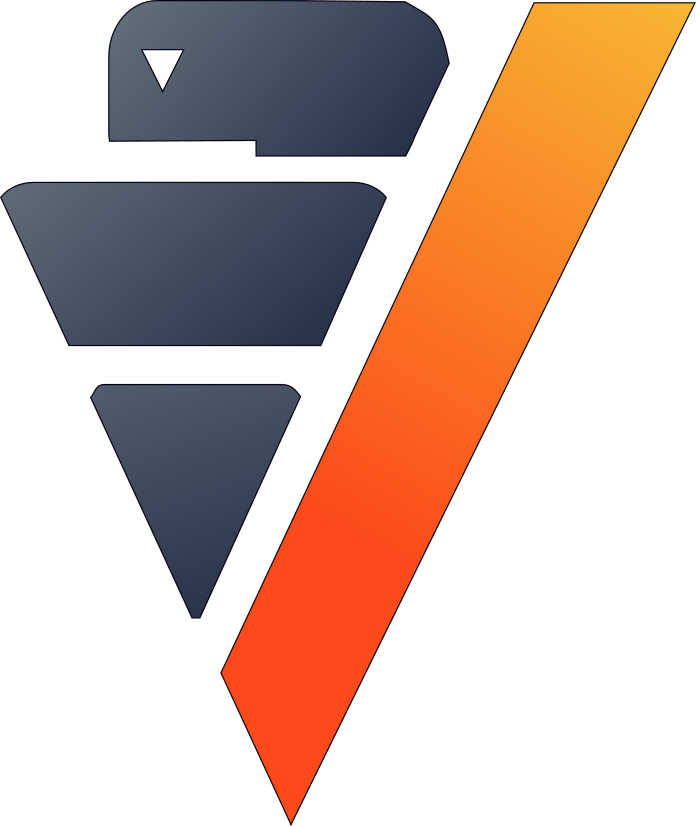

In [14]:
football["year"] = st.year(football["date"])
football.analytic('row_number', 
                  order_by = {"date": "desc"}, 
                  by = ["tournament", "year"] , 
                  name = "order_tournament")

We can filter the data by only considering the last games and top tournaments. 

37418 elements were filtered


,📅dateDate,123home_scoreInt,Abchome_teamVarchar(64),AbctournamentVarchar(84),Abcaway_teamVarchar(64),123away_scoreInt,010neutralBoolean,AbccountryVarchar(64),AbccityVarchar(56),AbcwinnerVarchar(64),123yearInteger,123order_tournamentInteger
1,1956-09-15,5,South Korea,AFC Asian Cup,Vietnam Republic,3,✅,Hong Kong,So Kon Po,South Korea,1956,1
2,1960-10-21,1,South Korea,AFC Asian Cup,Chinese Taipei,0,❌,South Korea,Seoul,South Korea,1960,1
3,1964-06-03,2,Israel,AFC Asian Cup,South Korea,1,❌,Israel,Ramat-Gan,Israel,1964,1
4,1968-05-19,2,Iran,AFC Asian Cup,Israel,1,❌,Iran,Teheran,Iran,1968,1
5,1972-05-19,2,Iran,AFC Asian Cup,South Korea,1,✅,Thailand,Bangkok,Iran,1972,1
6,1976-06-13,1,China PR,AFC Asian Cup,Iraq,0,✅,Iran,Teheran,China PR,1976,1
7,1980-09-30,3,Kuwait,AFC Asian Cup,South Korea,0,❌,Kuwait,Kuwait City,Kuwait,1980,1
8,2000-10-29,0,China PR,AFC Asian Cup,South Korea,1,✅,Lebanon,Beirut,South Korea,2000,1
9,2004-08-07,1,China PR,AFC Asian Cup,Japan,3,❌,China PR,Beijing,Japan,2004,1
10,2007-07-29,1,Iraq,AFC Asian Cup,Saudi Arabia,0,✅,Indonesia,Jakarta,Iraq,2007,1

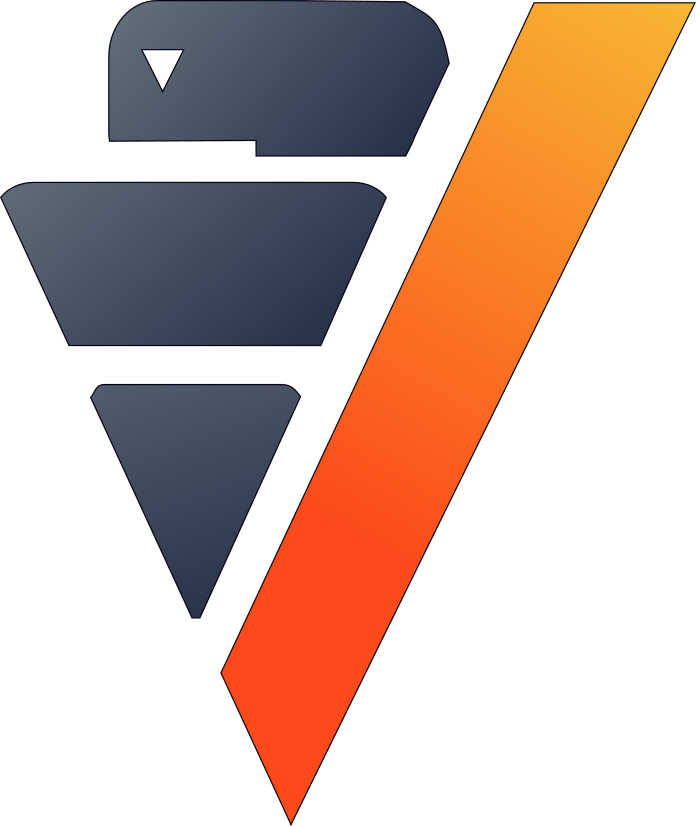

In [15]:
football.filter(conditions = [football["order_tournament"] == 1,
                              football["winner"] != None,
                              football["tournament"]._in(["FIFA World Cup", 
                                                          "UEFA Euro", 
                                                          "Copa América", 
                                                          "African Cup of Nations",
                                                          "AFC Asian Cup",
                                                          "Gold Cup"])])

Let's consider the World Cup as a special tournament. It is the only one where the confrontations between the top teams is possible. 

In [16]:
football["Word_Cup"] = st.decode(football["tournament"], 
                                 "FIFA World Cup", 1, 0)

We can compute all the number of cup-wins by team. As expected, Brazil and Germany are the top football teams.

,AbcwinnerVarchar(64),123nb_World_CupInteger,123nb_Continental_CupInteger
1,Brazil,4,8
2,Germany,4,3
3,Italy,3,1
4,Uruguay,2,8
5,Argentina,2,8
6,Spain,1,3
7,France,1,2
8,England,1,0
9,Mexico,0,6
10,Egypt,0,5

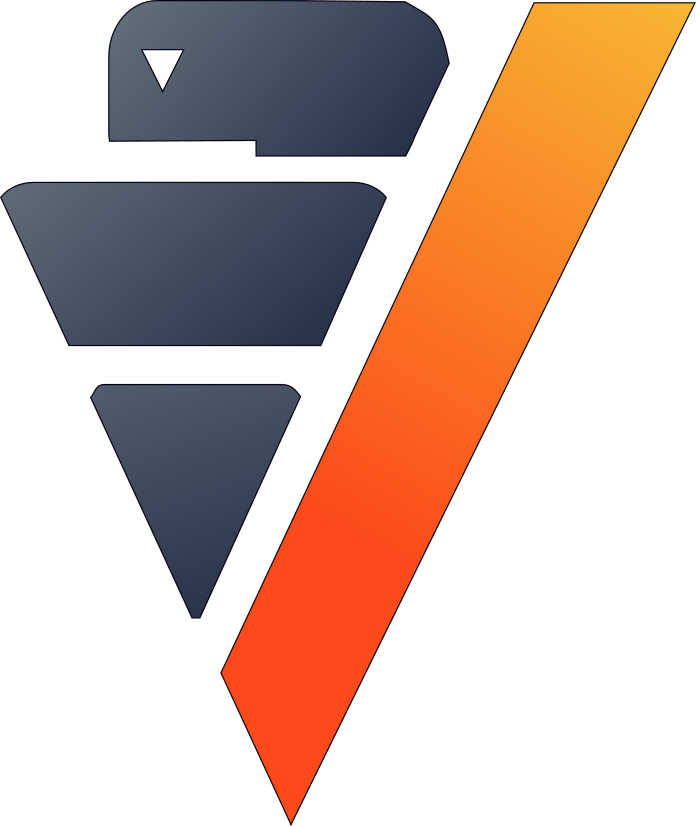

In [17]:
agg = [st.sum(football["Word_Cup"])._as("nb_World_Cup"),
       st.sum(1 - football["Word_Cup"])._as("nb_Continental_Cup")]
football_cup_winners = football.groupby(["winner"], agg)
football_cup_winners.sort({"nb_World_Cup": "desc",
                           "nb_Continental_Cup": "desc"}).head(10)

Let's export the result to our Vertica database.

,AbcwinnerVarchar(64),123nb_World_CupInteger,123nb_Continental_CupInteger
1,Brazil,4,8
2,Germany,4,3
3,Italy,3,1
4,Uruguay,2,8
5,Argentina,2,8
6,Spain,1,3
7,France,1,2
8,England,1,0
9,Mexico,0,6
10,Egypt,0,5

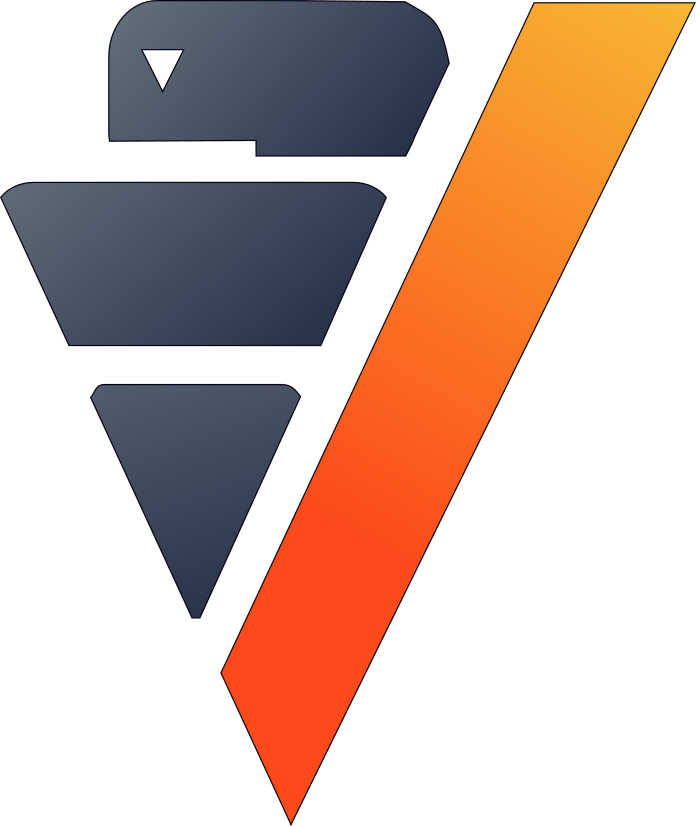

In [19]:
vp.drop("football_cup_winners", relation_type = "table")
football_cup_winners.to_db("football_cup_winners", 
                           relation_type = "table")

### Team Confederations

Looking into team confederations could help our analysis. For example, this might help us quantify skill differences between different continents. A team that had played a qualification of a specific location can only belong to that tournament confederation.

First let's encode the different continents so we can compute the correct aggregations.

,📅dateDate,Abchome_teamVarchar(64),Abcaway_teamVarchar(64),123home_scoreInt,123away_scoreInt,AbctournamentVarchar(84),AbccityVarchar(56),AbccountryVarchar(64),010neutralBoolean,123confederationInteger
1,1872-11-30,Scotland,England,0,0,Friendly,Glasgow,Scotland,❌,0
2,1873-03-08,England,Scotland,4,2,Friendly,London,England,❌,0
3,1874-03-07,Scotland,England,2,1,Friendly,Glasgow,Scotland,❌,0
4,1875-03-06,England,Scotland,2,2,Friendly,London,England,❌,0
5,1876-03-04,Scotland,England,3,0,Friendly,Glasgow,Scotland,❌,0
6,1876-03-25,Scotland,Wales,4,0,Friendly,Glasgow,Scotland,❌,0
7,1877-03-03,England,Scotland,1,3,Friendly,London,England,❌,0
8,1877-03-05,Wales,Scotland,0,2,Friendly,Wrexham,Wales,❌,0
9,1878-03-02,Scotland,England,7,2,Friendly,Glasgow,Scotland,❌,0
10,1878-03-23,Scotland,Wales,9,0,Friendly,Glasgow,Scotland,❌,0

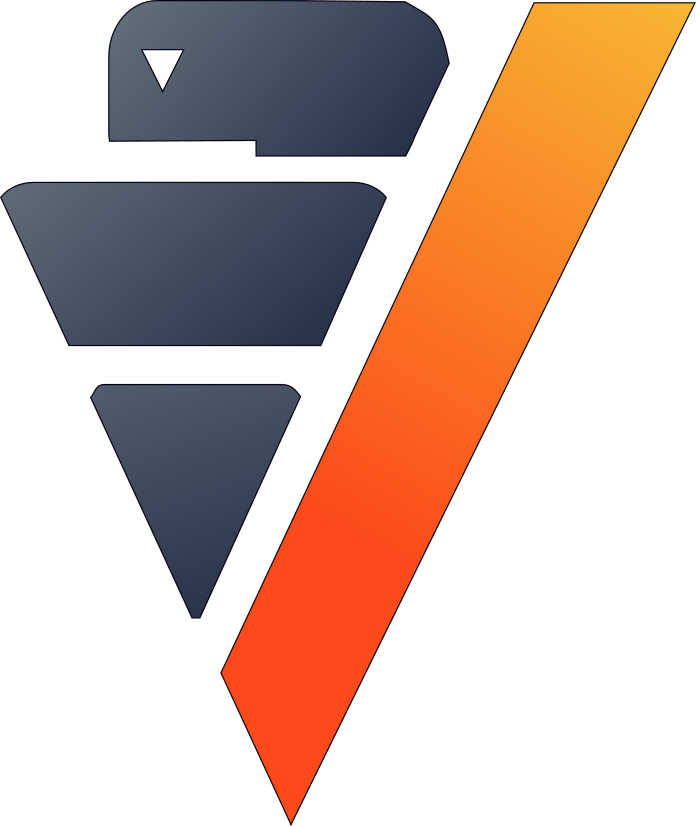

In [20]:
football = vp.read_csv("data/football.csv")
football.case_when('confederation', 
                   football["tournament"] == 'UEFA Euro qualification', 5,
                   football["tournament"] == 'African Cup of Nations qualification', 4,
                   football["tournament"] == 'AFC Asian Cup qualification', 3,
                   football["tournament"] == 'Copa América', 2,
                   football["tournament"] == 'Gold Cup', 1, 0)

We can aggregate the data and get each team's continent.

,Abchome_teamVarchar(64),123confederationInteger
1,Kernow,0
2,Martinique,1
3,New Zealand,0
4,Orkney,0
5,Saint Helena,0
6,Iran,3
7,South Africa,4
8,Sápmi,0
9,Morocco,4
10,Gozo,0

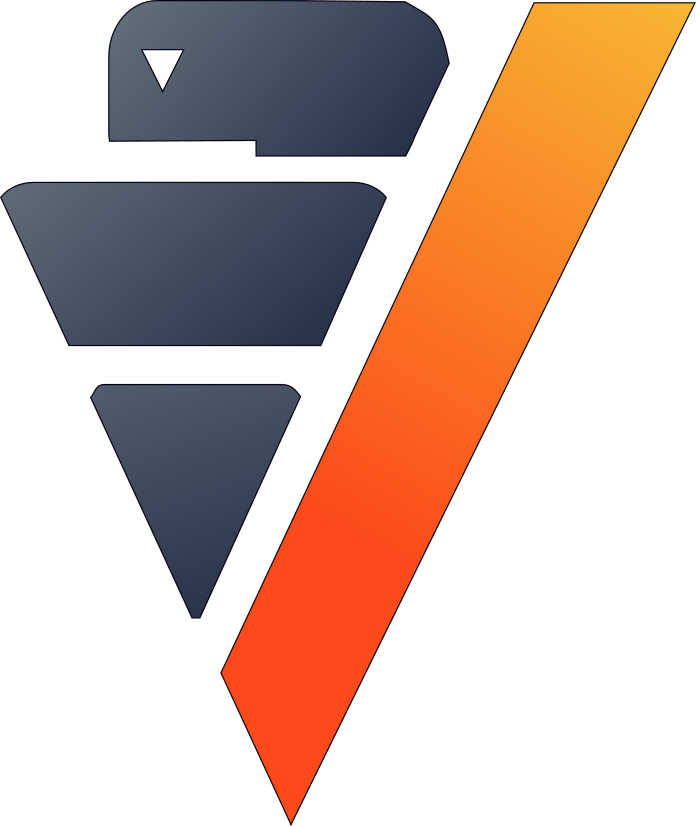

In [21]:
confederation = football.groupby(["home_team"],
                                 [st.max(football["confederation"])._as("confederation")])
display(confederation)

We can decode the previous label encoding.

,Abchome_teamVarchar(64),AbcconfederationVarchar(8)
1,Kernow,OFC
2,Martinique,CONCACAF
3,New Zealand,OFC
4,Orkney,OFC
5,Saint Helena,OFC
6,Iran,AFC
7,South Africa,CAF
8,Sápmi,OFC
9,Morocco,CAF
10,Gozo,OFC

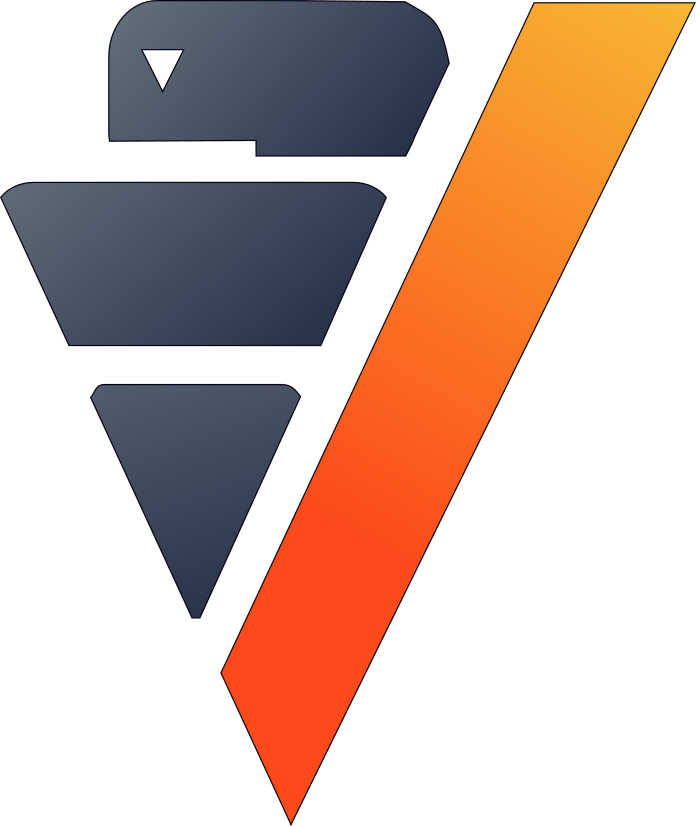

In [22]:
confederation["confederation"].decode(5, "UEFA",
                                      4, "CAF",
                                      3, "AFC",
                                      2, "CONMEBOL",
                                      1, "CONCACAF",
                                      "OFC")

Let's export the result to our Vertica database.

,AbcconfederationVarchar(8),AbcteamVarchar(64)
1,OFC,Kernow
2,CONCACAF,Martinique
3,OFC,New Zealand
4,OFC,Orkney
5,OFC,Saint Helena
6,AFC,Iran
7,CAF,South Africa
8,OFC,Sápmi
9,CAF,Morocco
10,OFC,Gozo

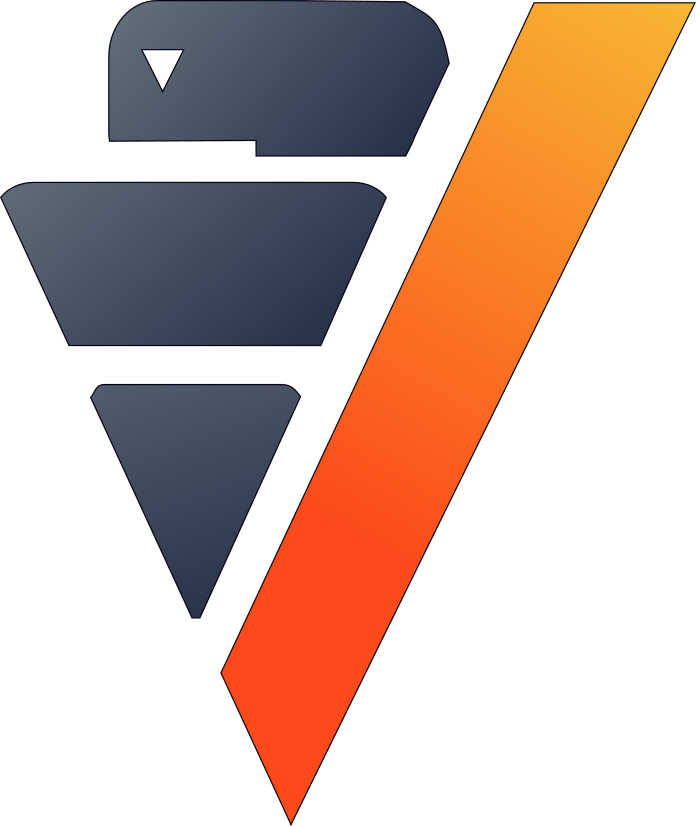

In [23]:
vp.drop("confederation")
confederation["home_team"].rename("team")
confederation.to_db(name = "confederation",
                    relation_type = "table")

### Team KPIs

We use just two variables to track teams: away_team and home_team. This makes it a bit difficult to compute new features. We need to duplicate the dataset and intervert the two teams. This way, we can compute KPIs using a partition by the first team to avoid double-counting any games.

3884 elements were filtered
3884 elements were filtered


,📅dateDate,AbctournamentVarchar(84),AbccountryVarchar(64),AbccityVarchar(56),Abcteam1Varchar(64),123team1_scoreInteger,Abcteam2Varchar(64),123team2_scoreInteger,123home_team_idInteger
1,1872-11-30,Friendly,Scotland,Glasgow,Scotland,0,England,0,1
2,1873-03-08,Friendly,England,London,England,4,Scotland,2,1
3,1874-03-07,Friendly,Scotland,Glasgow,Scotland,2,England,1,1
4,1875-03-06,Friendly,England,London,England,2,Scotland,2,1
5,1876-03-04,Friendly,Scotland,Glasgow,Scotland,3,England,0,1
6,1876-03-25,Friendly,Scotland,Glasgow,Scotland,4,Wales,0,1
7,1877-03-03,Friendly,England,London,England,1,Scotland,3,1
8,1877-03-05,Friendly,Wales,Wrexham,Wales,0,Scotland,2,1
9,1878-03-02,Friendly,Scotland,Glasgow,Scotland,7,England,2,1
10,1878-03-23,Friendly,Scotland,Glasgow,Scotland,9,Wales,0,1

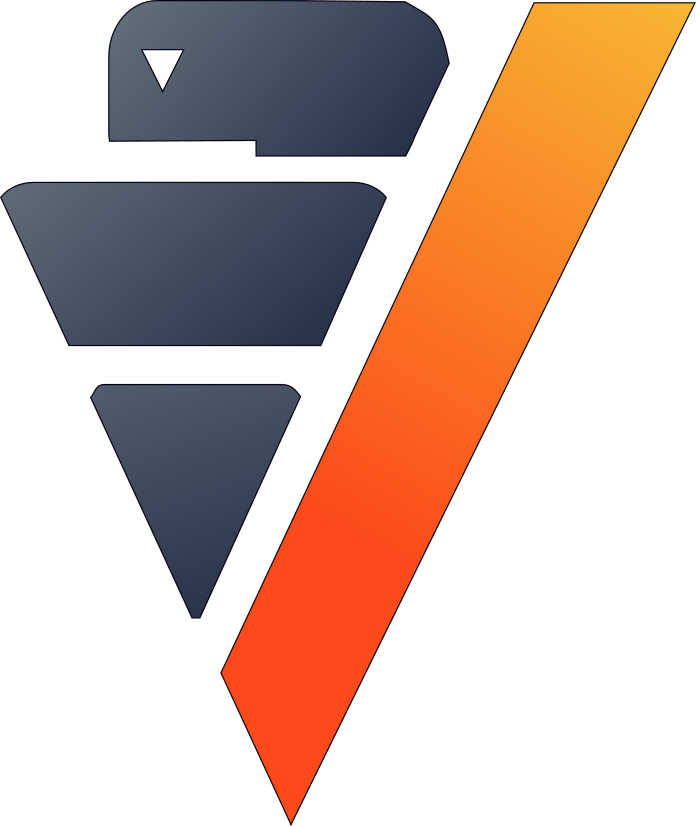

In [24]:
football = vp.vDataFrame("football_clean")
football.filter(st.year(football["date"]) <= 2015)
football["home_team"].rename("team1")
football["home_score"].rename("team1_score")
football["away_team"].rename("team2")
football["away_score"].rename("team2_score")
football["neutral"].decode(True, 0, 1)

football2 = vp.vDataFrame("football_clean")
football2.filter(st.year(football["date"]) <= 2015)
football2["home_team"].rename("team2")
football2["home_score"].rename("team2_score")
football2["away_team"].rename("team1")
football2["away_score"].rename("team1_score")
football2["neutral"].decode(True, 0, 2)


# Merging the 2 interverted datasets
all_matchs = football.append(football2)
all_matchs["neutral"].rename("home_team_id")

To compute the different aggregations, we need to add dummies which indicate the type of game and winner.

,📅dateDate,AbctournamentVarchar(84),AbccountryVarchar(64),AbccityVarchar(56),Abcteam1Varchar(64),123team1_scoreInteger,Abcteam2Varchar(64),123team2_scoreInteger,123home_team_idInteger,123World_TournamentInteger,123Continental_TournamentInteger,123Victory_team1Int,123DrawInt
1,1872-11-30,Friendly,Scotland,Glasgow,Scotland,0,England,0,1,0,0,0,1
2,1873-03-08,Friendly,England,London,England,4,Scotland,2,1,0,0,1,0
3,1874-03-07,Friendly,Scotland,Glasgow,Scotland,2,England,1,1,0,0,1,0
4,1875-03-06,Friendly,England,London,England,2,Scotland,2,1,0,0,0,1
5,1876-03-04,Friendly,Scotland,Glasgow,Scotland,3,England,0,1,0,0,1,0
6,1876-03-25,Friendly,Scotland,Glasgow,Scotland,4,Wales,0,1,0,0,1,0
7,1877-03-03,Friendly,England,London,England,1,Scotland,3,1,0,0,0,0
8,1877-03-05,Friendly,Wales,Wrexham,Wales,0,Scotland,2,1,0,0,0,0
9,1878-03-02,Friendly,Scotland,Glasgow,Scotland,7,England,2,1,0,0,1,0
10,1878-03-23,Friendly,Scotland,Glasgow,Scotland,9,Wales,0,1,0,0,1,0

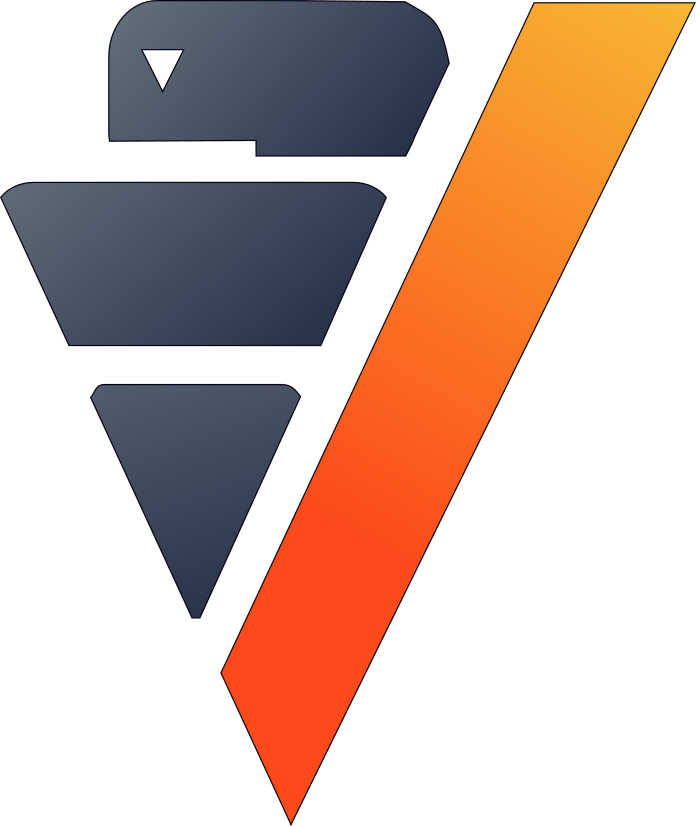

In [25]:
all_matchs["World_Tournament"] = st.case_when(all_matchs["tournament"]._in(["FIFA World Cup",
                                                                            "Confederations Cup"]), 1, 0)
all_matchs["Continental_Tournament"] = st.case_when(all_matchs["tournament"]._in([
                                                                            "UEFA Euro", 
                                                                            "Copa América", 
                                                                            "African Cup of Nations",
                                                                            "AFC Asian Cup",
                                                                            "Gold Cup",
                                                                            "FIFA World Cup qualification"]), 1, 0)
all_matchs["Victory_team1"] = (all_matchs["team1_score"] > all_matchs["team2_score"])
all_matchs["Victory_team1"].astype("int")
all_matchs["Draw"] = (all_matchs["team1_score"] == all_matchs["team2_score"])
all_matchs["Draw"].astype("int")

Now we can compute each team's KPI.

,Abcteam1Varchar(64),123Number_Games_World_TournamentInteger,123Integer,123Percent_Victory_World_TournamentFloat,123Float,123Percent_Victory_HomeFloat,123Percent_Victory_AwayFloat,123Percent_VictoryFloat,123Percent_DrawFloat,123Avg_goalsFloat,123Avg_goals_concededFloat
1,Brazil,137,,0.678832116788321,,0.733333333333333,0.59375,0.635091496232508,0.20021528525296,2.19375672766416,0.93756727664155
2,Germany,120,,0.6,,0.608391608391608,0.470212765957447,0.555369127516778,0.208053691275168,2.0998322147651,1.17953020134228
3,Italy,91,,0.527472527472527,,0.643884892086331,0.346456692913386,0.524568393094289,0.282868525896414,1.69588313413015,0.98273572377158
4,Argentina,87,,0.540229885057471,,0.638095238095238,0.406060606060606,0.536060279870829,0.248654467168999,1.86544671689989,1.05059203444564
5,Mexico,75,,0.306666666666667,,0.542483660130719,0.423566878980892,0.495,0.2375,1.7475,1.07625
6,Spain,69,,0.521739130434783,,0.676855895196507,0.465686274509804,0.581395348837209,0.224806201550388,1.96744186046512,0.908527131782946
7,France,69,,0.536231884057971,,0.532110091743119,0.363636363636364,0.480818414322251,0.214833759590793,1.75831202046036,1.34271099744246
8,England,62,,0.419354838709677,,0.61878453038674,0.530864197530864,0.565762004175365,0.241127348643006,2.19937369519833,0.992693110647182
9,Uruguay,61,,0.409836065573771,,0.5,0.300724637681159,0.430274135876043,0.245530393325387,1.57568533969011,1.26460071513707
10,Netherlands,50,,0.54,,0.542253521126761,0.385214007782101,0.503373819163293,0.228070175438596,2.06207827260459,1.24966261808367

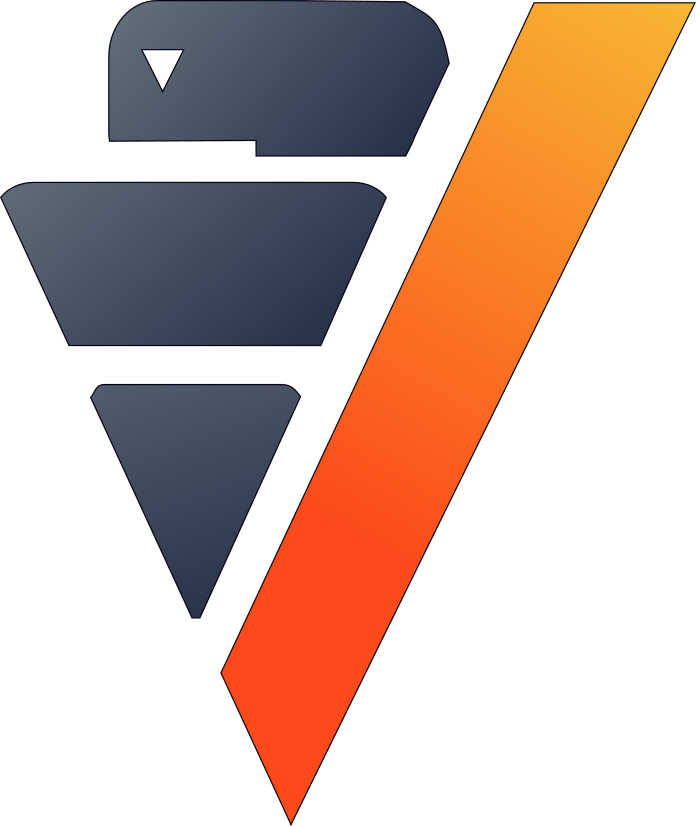

In [26]:
teams_kpi = all_matchs.groupby(["team1"],
   [st.sum(all_matchs["World_Tournament"])._as("Number_Games_World_Tournament"),
    st.sum(all_matchs["Continental_Tournament"])._as("Number_Games_Continental_Tournament"),
    st.avg(st.decode(all_matchs["World_Tournament"], 
                     1, all_matchs["Victory_team1"]))._as("Percent_Victory_World_Tournament"),
    st.avg(st.decode(all_matchs["Continental_Tournament"], 
                     1, all_matchs["Victory_team1"]))._as("Percent_Victory_Continental_Tournament"),
    st.avg(st.case_when((all_matchs["home_team_id"] == 1) & 
                        (all_matchs["World_Tournament"] == 0) &
                        (all_matchs["Continental_Tournament"] == 0), 
                        all_matchs["Victory_team1"], None))._as("Percent_Victory_Home"),
    st.avg(st.case_when((all_matchs["home_team_id"] != 1) & 
                        (all_matchs["World_Tournament"] == 0) &
                        (all_matchs["Continental_Tournament"] == 0), 
                        all_matchs["Victory_team1"], None))._as("Percent_Victory_Away"),
    st.avg(all_matchs["Victory_team1"])._as("Percent_Victory"),
    st.avg(all_matchs["Draw"])._as("Percent_Draw"),
    st.avg(all_matchs["team1_score"])._as("Avg_goals"),
    st.avg(all_matchs["team2_score"])._as("Avg_goals_conceded")]).sort({"Number_Games_World_Tournament": "desc"})
display(teams_kpi)

We can join the different information about the cup winners to enrich our dataset. We'll be using this later, so let's export it to our Vertica database.

,Abcteam1Varchar(64),123Number_Games_World_TournamentInteger,123Integer,123Percent_Victory_World_TournamentFloat,123Float,123Percent_Victory_HomeFloat,123Percent_Victory_AwayFloat,123Percent_VictoryFloat,123Percent_DrawFloat,123Avg_goalsFloat,123Avg_goals_concededFloat,123nb_World_CupInteger,123nb_Continental_CupInteger
1,Brazil,137,,0.678832116788321,,0.733333333333333,0.59375,0.635091496232508,0.20021528525296,2.19375672766416,0.93756727664155,4,8
2,Germany,120,,0.6,,0.608391608391608,0.470212765957447,0.555369127516778,0.208053691275168,2.0998322147651,1.17953020134228,4,3
3,Italy,91,,0.527472527472527,,0.643884892086331,0.346456692913386,0.524568393094289,0.282868525896414,1.69588313413015,0.98273572377158,3,1
4,Argentina,87,,0.540229885057471,,0.638095238095238,0.406060606060606,0.536060279870829,0.248654467168999,1.86544671689989,1.05059203444564,2,8
5,Mexico,75,,0.306666666666667,,0.542483660130719,0.423566878980892,0.495,0.2375,1.7475,1.07625,0,6
6,France,69,,0.536231884057971,,0.532110091743119,0.363636363636364,0.480818414322251,0.214833759590793,1.75831202046036,1.34271099744246,1,2
7,Spain,69,,0.521739130434783,,0.676855895196507,0.465686274509804,0.581395348837209,0.224806201550388,1.96744186046512,0.908527131782946,1,3
8,England,62,,0.419354838709677,,0.61878453038674,0.530864197530864,0.565762004175365,0.241127348643006,2.19937369519833,0.992693110647182,1,0
9,Uruguay,61,,0.409836065573771,,0.5,0.300724637681159,0.430274135876043,0.245530393325387,1.57568533969011,1.26460071513707,2,8
10,Netherlands,50,,0.54,,0.542253521126761,0.385214007782101,0.503373819163293,0.228070175438596,2.06207827260459,1.24966261808367,0,1

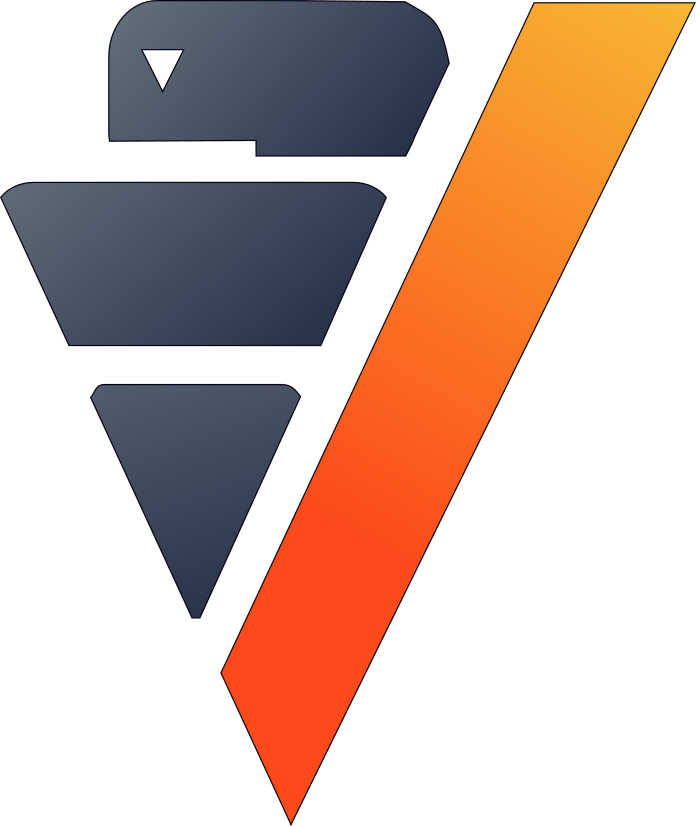

In [27]:
vp.drop("teams_kpi", relation_type = "table")
teams_kpi = teams_kpi.join(football_cup_winners,
                           on = {"team1": "winner"},
                           how = "left",
                           expr2 = ["nb_World_Cup", 
                                    "nb_Continental_Cup"]).to_db("teams_kpi", relation_type = "table")
display(teams_kpi)

Let's add each team's confederation to our dataset.

,Abcteam1Varchar(64),123Number_Games_World_TournamentInteger,123Integer,123Percent_Victory_World_TournamentFloat,123Float,123Percent_Victory_HomeFloat,123Percent_Victory_AwayFloat,123Percent_VictoryFloat,123Percent_DrawFloat,123Avg_goalsFloat,123Avg_goals_concededFloat,123nb_World_CupInteger,123nb_Continental_CupInteger,AbcconfederationVarchar(8)
1,Madagascar,0,,[null],,0.464285714285714,0.32183908045977,0.366666666666667,0.194444444444444,1.33333333333333,1.63333333333333,[null],[null],CAF
2,North Vietnam,0,,[null],,[null],0.210526315789474,0.210526315789474,0.157894736842105,1.63157894736842,2.26315789473684,[null],[null],OFC
3,Abkhazia,0,,[null],,[null],0.166666666666667,0.166666666666667,0.5,1.0,1.5,[null],[null],OFC
4,Canada,6,,0.0,,0.338709677419355,0.281481481481481,0.331412103746398,0.239193083573487,1.04899135446686,1.39769452449568,0,2,CONCACAF
5,Monaco,0,,[null],,[null],0.166666666666667,0.166666666666667,0.166666666666667,1.16666666666667,8.33333333333333,[null],[null],OFC
6,Saint Pierre and Miquelon,0,,[null],,[null],0.0,0.0,0.0,0.166666666666667,10.3333333333333,[null],[null],OFC
7,Algeria,13,,0.230769230769231,,0.580645161290323,0.31638418079096,0.415217391304348,0.280434782608696,1.35434782608696,1.0304347826087,0,1,CAF
8,Iran,12,,0.0833333333333333,,0.641509433962264,0.430379746835443,0.534368070953437,0.261640798226164,1.84035476718404,0.835920177383592,0,2,AFC
9,Comoros,0,,[null],,0.0,0.142857142857143,0.0714285714285714,0.285714285714286,0.5,1.71428571428571,[null],[null],CAF
10,Namibia,0,,[null],,0.351851851851852,0.195402298850575,0.236842105263158,0.284210526315789,1.01578947368421,1.53157894736842,[null],[null],CAF

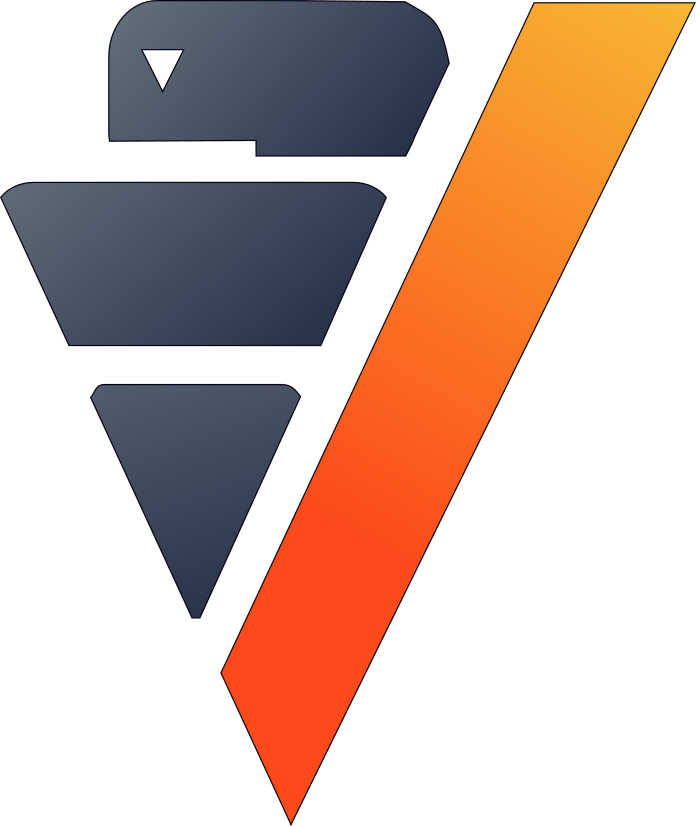

In [28]:
teams_kpi = teams_kpi.join(confederation,
                           how = "left",
                           on = {"team1": "team"},
                           expr2 = ["confederation"])
display(teams_kpi)

Since clustering will use different statistics, we need to normalize the data. We'll also create a dummy that will equal 1 if the team won at least one World Cup.

,Abcteam1Varchar(64),123Number_Games_World_TournamentFloat,123Float,123Percent_Victory_World_TournamentFloat,123Float,123Percent_Victory_HomeFloat,123Percent_Victory_AwayFloat,123Percent_VictoryFloat,123Percent_DrawFloat,123Avg_goalsFloat,123Avg_goals_concededFloat,123nb_World_CupInteger,123nb_Continental_CupFloat,AbcconfederationVarchar(8),123Word_Cup_VictoryInt
1,Madagascar,0.0,,[null],,0.464285714285714,0.32183908045977,0.366666666666667,0.194444444444444,1.33333333333333,1.63333333333333,[null],[null],CAF,[null]
2,North Vietnam,0.0,,[null],,[null],0.210526315789474,0.210526315789474,0.157894736842105,1.63157894736842,2.26315789473684,[null],[null],OFC,[null]
3,Abkhazia,0.0,,[null],,[null],0.166666666666667,0.166666666666667,0.5,1.0,1.5,[null],[null],OFC,[null]
4,Canada,0.043795620437956,,0.0,,0.338709677419355,0.281481481481481,0.331412103746398,0.239193083573487,1.04899135446686,1.39769452449568,0,0.25,CONCACAF,0
5,Monaco,0.0,,[null],,[null],0.166666666666667,0.166666666666667,0.166666666666667,1.16666666666667,8.33333333333333,[null],[null],OFC,[null]
6,Saint Pierre and Miquelon,0.0,,[null],,[null],0.0,0.0,0.0,0.166666666666667,10.3333333333333,[null],[null],OFC,[null]
7,Algeria,0.094890510948905,,0.230769230769231,,0.580645161290323,0.31638418079096,0.415217391304348,0.280434782608696,1.35434782608696,1.0304347826087,0,0.125,CAF,0
8,Iran,0.087591240875912,,0.0833333333333333,,0.641509433962264,0.430379746835443,0.534368070953437,0.261640798226164,1.84035476718404,0.835920177383592,0,0.25,AFC,0
9,Comoros,0.0,,[null],,0.0,0.142857142857143,0.0714285714285714,0.285714285714286,0.5,1.71428571428571,[null],[null],CAF,[null]
10,Namibia,0.0,,[null],,0.351851851851852,0.195402298850575,0.236842105263158,0.284210526315789,1.01578947368421,1.53157894736842,[null],[null],CAF,[null]

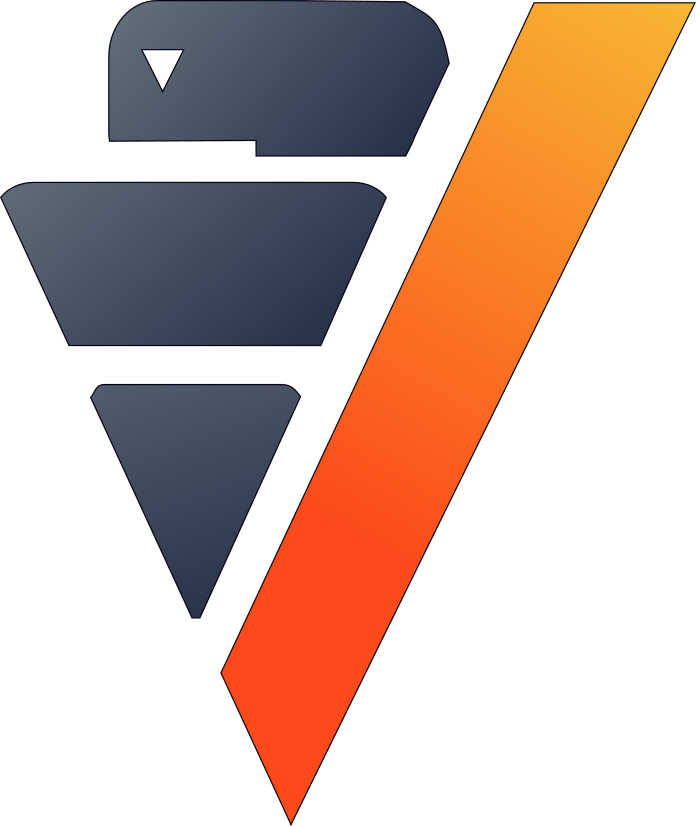

In [29]:
teams_kpi.normalize(columns = ["Number_Games_Continental_Tournament", 
                               "Number_Games_World_Tournament",
                               "nb_Continental_Cup"],
                    method = "minmax")
teams_kpi["Word_Cup_Victory"] = teams_kpi["nb_World_Cup"] > 0
teams_kpi["Word_Cup_Victory"].astype("int")

Some data is missing; this is because only top teams won major tournaments. Besides, some non-professional teams may not have a stadium.

,count
,272.0
,272.0
,272.0
,77.0
,213.0
,243.0
,263.0
,272.0
,272.0
,272.0

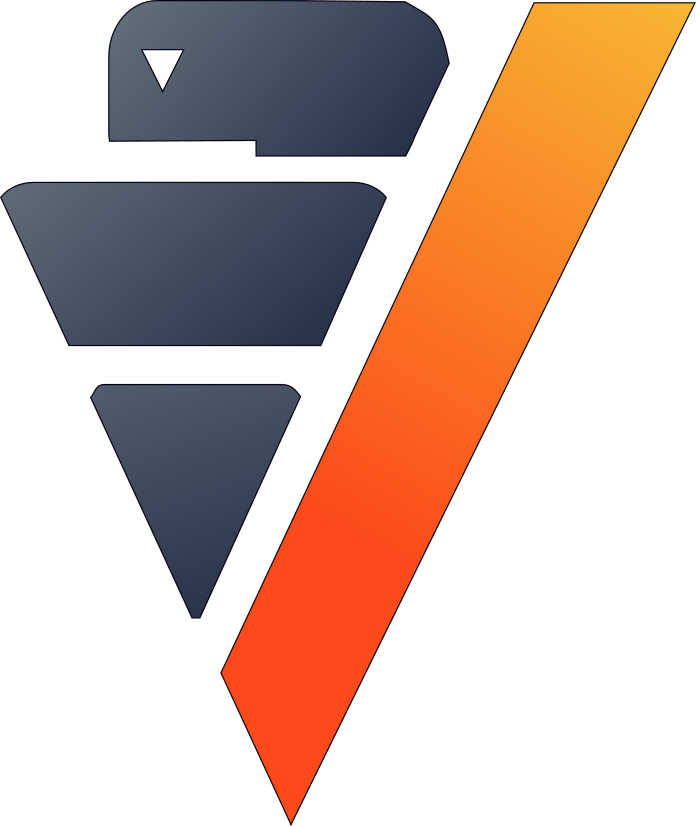

In [30]:
teams_kpi.count()

Let's impute the missing values by 0.

,Abcteam1Varchar(64),123Number_Games_World_TournamentFloat,123Float,123Percent_Victory_World_TournamentFloat,123Float,123Percent_Victory_HomeFloat,123Percent_Victory_AwayFloat,123Percent_VictoryFloat,123Percent_DrawFloat,123Avg_goalsFloat,123Avg_goals_concededFloat,123nb_World_CupInteger,123nb_Continental_CupFloat,AbcconfederationVarchar(8),123Word_Cup_VictoryInt
1,Madagascar,0.0,,0.0,,0.464285714285714,0.32183908045977,0.366666666666667,0.194444444444444,1.33333333333333,1.63333333333333,0,0.0,CAF,0
2,North Vietnam,0.0,,0.0,,0.0,0.210526315789474,0.210526315789474,0.157894736842105,1.63157894736842,2.26315789473684,0,0.0,OFC,0
3,Abkhazia,0.0,,0.0,,0.0,0.166666666666667,0.166666666666667,0.5,1.0,1.5,0,0.0,OFC,0
4,Canada,0.043795620437956,,0.0,,0.338709677419355,0.281481481481481,0.331412103746398,0.239193083573487,1.04899135446686,1.39769452449568,0,0.25,CONCACAF,0
5,Monaco,0.0,,0.0,,0.0,0.166666666666667,0.166666666666667,0.166666666666667,1.16666666666667,8.33333333333333,0,0.0,OFC,0
6,Saint Pierre and Miquelon,0.0,,0.0,,0.0,0.0,0.0,0.0,0.166666666666667,10.3333333333333,0,0.0,OFC,0
7,Algeria,0.094890510948905,,0.230769230769231,,0.580645161290323,0.31638418079096,0.415217391304348,0.280434782608696,1.35434782608696,1.0304347826087,0,0.125,CAF,0
8,Iran,0.087591240875912,,0.0833333333333333,,0.641509433962264,0.430379746835443,0.534368070953437,0.261640798226164,1.84035476718404,0.835920177383592,0,0.25,AFC,0
9,Comoros,0.0,,0.0,,0.0,0.142857142857143,0.0714285714285714,0.285714285714286,0.5,1.71428571428571,0,0.0,CAF,0
10,Namibia,0.0,,0.0,,0.351851851851852,0.195402298850575,0.236842105263158,0.284210526315789,1.01578947368421,1.53157894736842,0,0.0,CAF,0

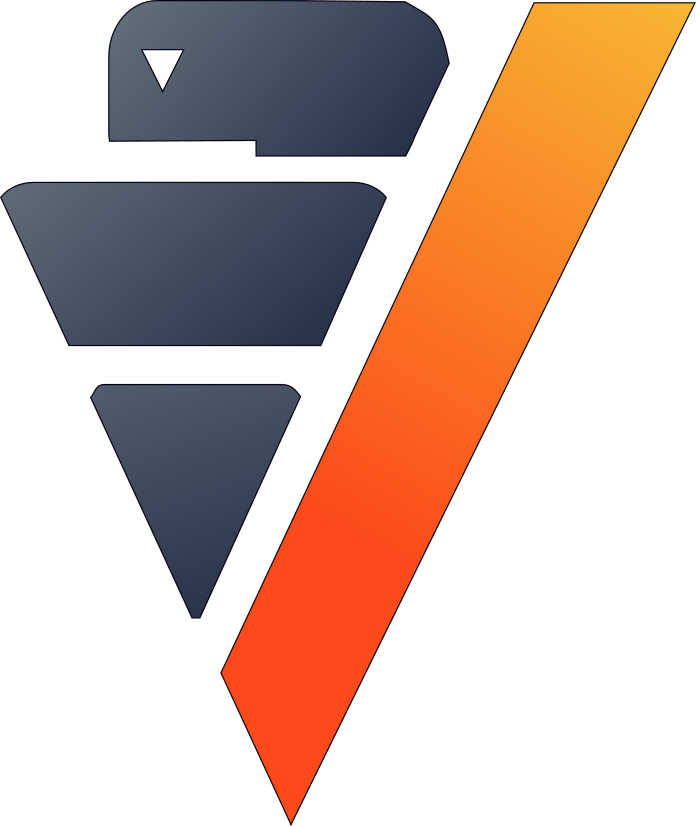

In [31]:
teams_kpi.fillna({"Percent_Victory_Away": 0,
                  "Percent_Victory_Home": 0,
                  "Percent_Victory_Continental_Tournament": 0,
                  "Percent_Victory_World_Tournament": 0,
                  "nb_World_Cup": 0,
                  "Word_Cup_Victory": 0,
                  "nb_Continental_Cup": 0,
                  "confederation": "OFC"})

Let's export the result to our Vertica database.

,Abcteam1Varchar(64),"123Number_Games_World_TournamentNumeric(34,15)","123Numeric(34,15)",123Percent_Victory_World_TournamentFloat,123Float,123Percent_Victory_HomeFloat,123Percent_Victory_AwayFloat,123Percent_VictoryFloat,123Percent_DrawFloat,123Avg_goalsFloat,123Avg_goals_concededFloat,123nb_World_CupInt,"123nb_Continental_CupNumeric(34,15)",AbcconfederationVarchar(8),123Word_Cup_VictoryInt
1,Abkhazia,0.0,,0.0,,0.0,0.166666666666667,0.166666666666667,0.5,1.0,1.5,0,0.0,OFC,0
2,Afghanistan,0.0,,0.0,,0.4,0.295774647887324,0.284090909090909,0.204545454545455,1.07954545454545,2.05681818181818,0,0.0,AFC,0
3,Albania,0.0,,0.0,,0.404255319148936,0.173076923076923,0.23972602739726,0.222602739726027,0.900684931506849,1.5958904109589,0,0.0,UEFA,0
4,Alderney,0.0,,0.0,,0.0,0.0833333333333333,0.0833333333333333,0.0,0.583333333333333,4.33333333333333,0,0.0,OFC,0
5,Algeria,0.094890510948905,,0.230769230769231,,0.580645161290323,0.31638418079096,0.415217391304348,0.280434782608696,1.35434782608696,1.0304347826087,0,0.125,CAF,0
6,American Samoa,0.0,,0.0,,0.0,0.114285714285714,0.0930232558139535,0.0232558139534884,0.627906976744186,6.44186046511628,0,0.0,OFC,0
7,Andalusia,0.0,,0.0,,0.636363636363636,0.0,0.636363636363636,0.363636363636364,2.0,0.818181818181818,0,0.0,OFC,0
8,Andorra,0.0,,0.0,,0.0571428571428571,0.0,0.0229007633587786,0.0763358778625954,0.282442748091603,2.82442748091603,0,0.0,UEFA,0
9,Angola,0.021897810218978,,0.0,,0.5625,0.253521126760563,0.352750809061489,0.352750809061489,1.1747572815534,1.042071197411,0,0.0,CAF,0
10,Anguilla,0.0,,0.0,,0.0,0.09375,0.0625,0.0625,0.666666666666667,4.04166666666667,0,0.0,OFC,0

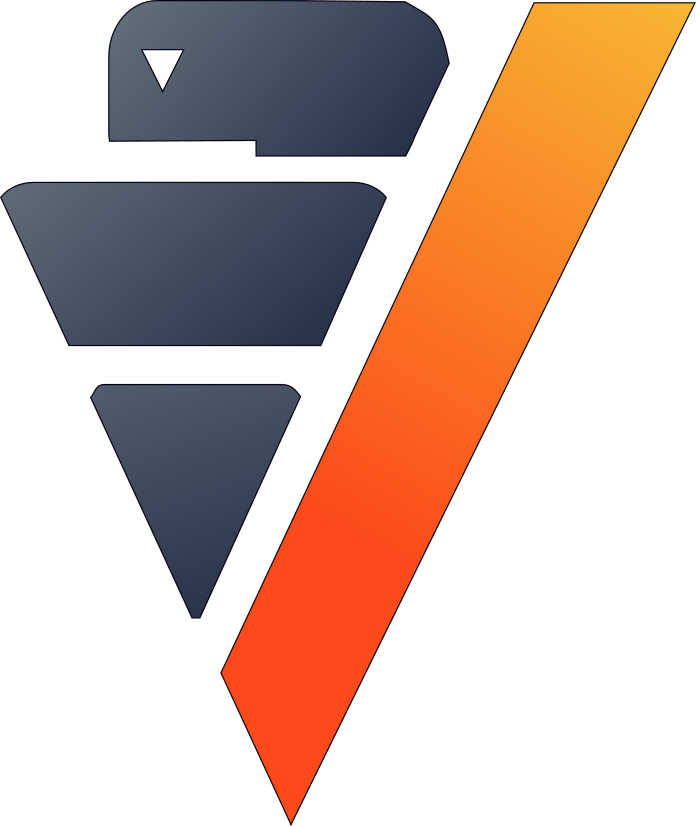

In [32]:
vp.drop("football_clustering", relation_type = "table")
teams_kpi.to_db("football_clustering", 
                relation_type = "table",
                inplace = True)

## Team Rankings with k-means

To compute a k-means model, we need to find a value for 'k.' Let's draw an elbow curve to find a suitable number of clusters.

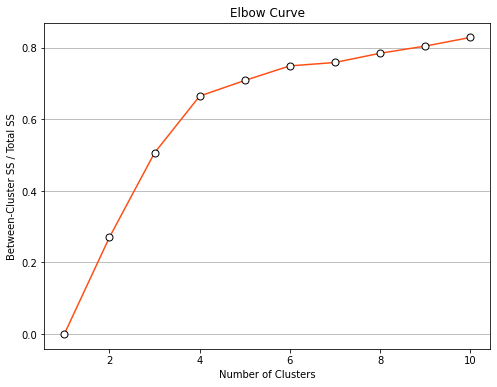

In [33]:
%matplotlib inline
from verticapy.learn.model_selection import elbow
predictors = ['Word_Cup_Victory',  
              'nb_Continental_Cup',
              'Number_Games_World_Tournament',    
              'Number_Games_Continental_Tournament',   
              'Percent_Victory_World_Tournament',
              'Percent_Victory_Continental_Tournament',  
              'Percent_Victory_Home',
              'Percent_Victory_Away']
elbow = elbow('football_clustering',
              predictors,
              n_cluster = (1, 11))

6 seems to be a good number of clusters. To help the algorithm to converge to meaningful clusters, we can initialize the clusters with different types of centroid levels. For example, we can associate very good teams (champions) to World Cups Winners, good teams to continental Cup Winners, etc. This will let us to properly weigh the performance of each team relatve to the strength of their region.

,123word_cup_victoryFloat,123nb_continental_cupFloat,123number_games_world_tournamentFloat,123Float,123percent_victory_world_tournamentFloat,123Float,123percent_victory_homeFloat,123percent_victory_awayFloat
1,0.0,0.0,0.0,,0.0,,0.0775017129231248,0.173344405066906
2,0.0,0.0,0.0,,0.0,,0.593941062388084,0.260025467557148
3,0.0,0.00416666666666667,0.00129764801297648,,0.00185185185185185,,0.450153680750178,0.256408127045046
4,0.0,0.0361842105263158,0.050710718401844,,0.113992166132427,,0.507846828538841,0.318140092013545
5,0.0,0.159090909090909,0.208803362088034,,0.342376891632991,,0.55005649660918,0.356151404084586
6,1.0,0.515625,0.635036496350365,,0.529212056011815,,0.61893194865411,0.434673942286204

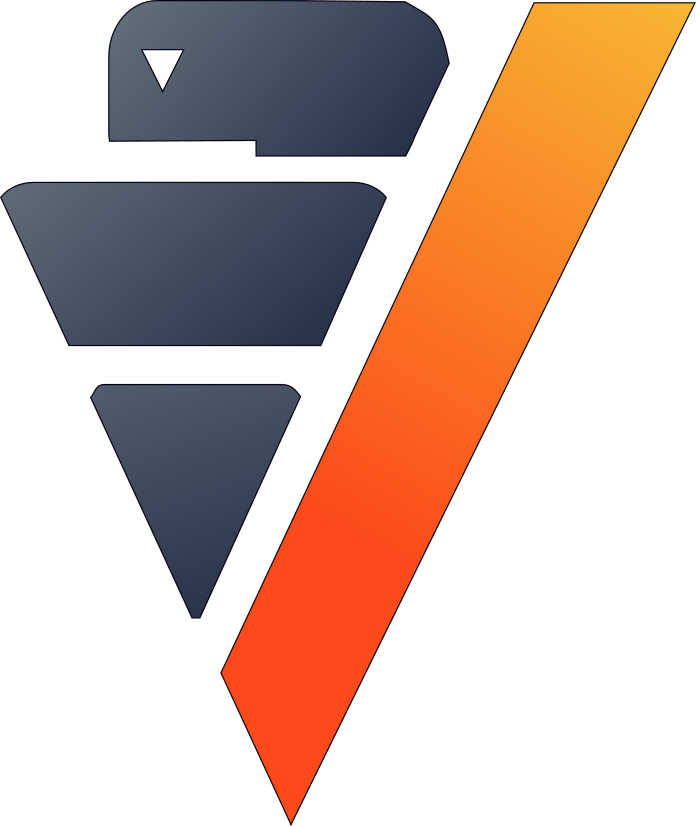

In [34]:
from verticapy.learn.cluster import KMeans
        # w_cup c_cup w_games c_games w_vict c_vict h_vict a_vict
init =  [(0,    0,       0,  0.05,      0,    0,      0, 0.05), # very bad
         (0,    0,       0,  0.30,      0, 0.25,   0.30, 0.10), # bad
         (0,    0,    0.05,  0.40,   0.15, 0.35,   0.40, 0.20), # outsiders
         (0, 0.10,    0.15,  0.50,   0.20, 0.45,   0.50, 0.30), # good
         (0, 0.20,    0.30,  0.40,   0.40, 0.55,   0.60, 0.40), # strong
         (1,  0.5,       1,  0.80,   0.70, 0.65,   0.75, 0.55)] # champions  
model_kmeans = KMeans("fifa_clusters", 
                      n_cluster = 6,
                      init = init)
model_kmeans.fit("football_clustering", predictors)
model_kmeans.cluster_centers_

Let's add the prediction to the vDataFrame.

,Abcteam1Varchar(64),"123Number_Games_World_TournamentNumeric(34,15)","123Numeric(34,15)",123Percent_Victory_World_TournamentFloat,123Float,123Percent_Victory_HomeFloat,123Percent_Victory_AwayFloat,123Percent_VictoryFloat,123Percent_DrawFloat,123Avg_goalsFloat,123Avg_goals_concededFloat,123nb_World_CupInt,"123nb_Continental_CupNumeric(34,15)",AbcconfederationVarchar(8),123Word_Cup_VictoryInt,123fifa_rankInteger
1,Abkhazia,0.0,,0.0,,0.0,0.166666666666667,0.166666666666667,0.5,1.0,1.5,0,0.0,OFC,0,0
2,Afghanistan,0.0,,0.0,,0.4,0.295774647887324,0.284090909090909,0.204545454545455,1.07954545454545,2.05681818181818,0,0.0,AFC,0,2
3,Albania,0.0,,0.0,,0.404255319148936,0.173076923076923,0.23972602739726,0.222602739726027,0.900684931506849,1.5958904109589,0,0.0,UEFA,0,2
4,Alderney,0.0,,0.0,,0.0,0.0833333333333333,0.0833333333333333,0.0,0.583333333333333,4.33333333333333,0,0.0,OFC,0,0
5,Algeria,0.094890510948905,,0.230769230769231,,0.580645161290323,0.31638418079096,0.415217391304348,0.280434782608696,1.35434782608696,1.0304347826087,0,0.125,CAF,0,3
6,American Samoa,0.0,,0.0,,0.0,0.114285714285714,0.0930232558139535,0.0232558139534884,0.627906976744186,6.44186046511628,0,0.0,OFC,0,0
7,Andalusia,0.0,,0.0,,0.636363636363636,0.0,0.636363636363636,0.363636363636364,2.0,0.818181818181818,0,0.0,OFC,0,1
8,Andorra,0.0,,0.0,,0.0571428571428571,0.0,0.0229007633587786,0.0763358778625954,0.282442748091603,2.82442748091603,0,0.0,UEFA,0,0
9,Angola,0.021897810218978,,0.0,,0.5625,0.253521126760563,0.352750809061489,0.352750809061489,1.1747572815534,1.042071197411,0,0.0,CAF,0,2
10,Anguilla,0.0,,0.0,,0.0,0.09375,0.0625,0.0625,0.666666666666667,4.04166666666667,0,0.0,OFC,0,0

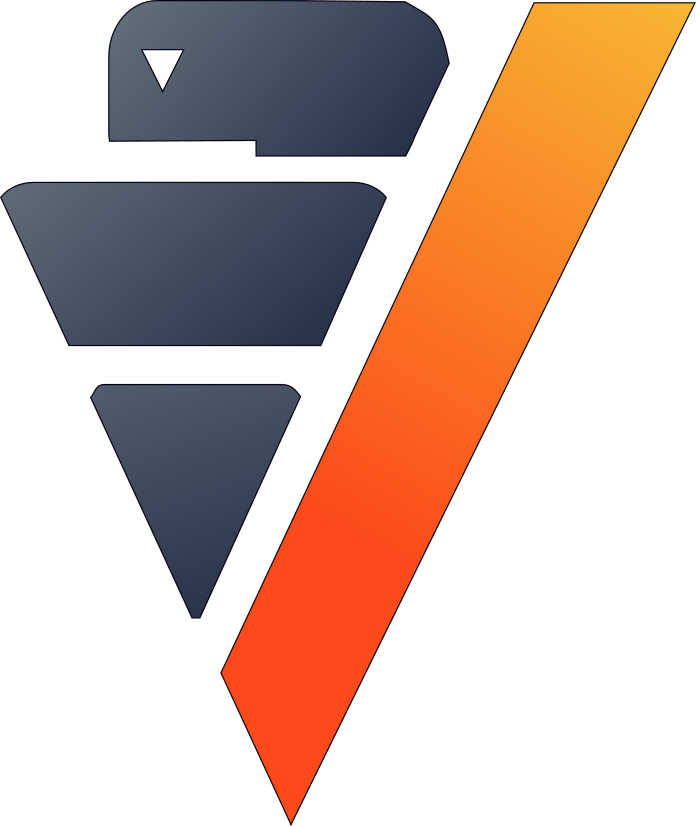

In [35]:
model_kmeans.predict(teams_kpi, 
                     name = "fifa_rank")

Let's look at the strongest group, which includes well-known teams like Argentina, Brazil, and France.

,Abcteam1Varchar(64),123fifa_rankInteger
1,Uruguay,5
2,Spain,5
3,Italy,5
4,Germany,5
5,France,5
6,England,5
7,Brazil,5
8,Argentina,5

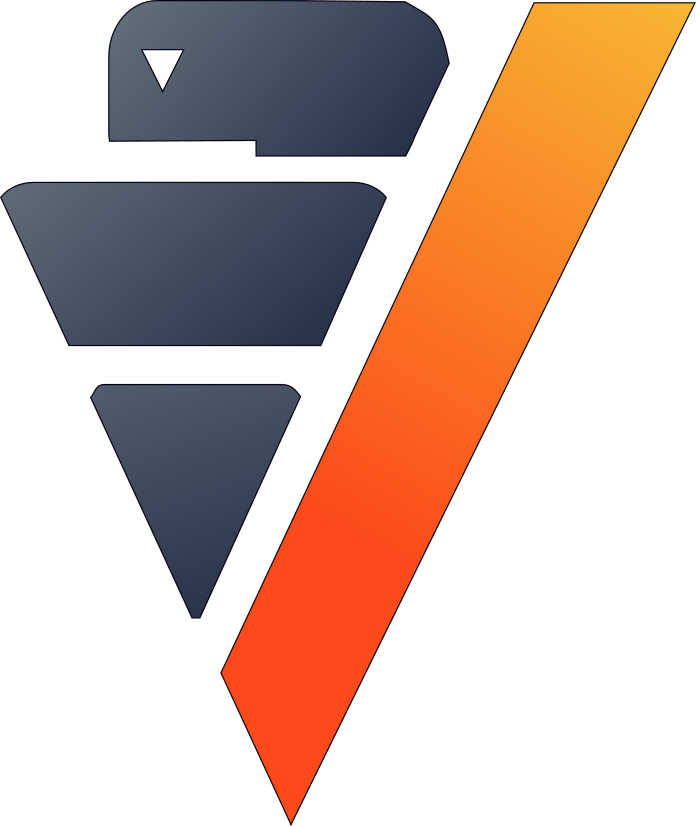

In [36]:
teams_kpi.search(conditions = [teams_kpi["fifa_rank"] == 5],
                 usecols = ["team1", "fifa_rank"],
                 order_by = ["fifa_rank"]).head(10)

The weakest group includes less well-known teams.

,Abcteam1Varchar(64),123fifa_rankInteger
1,Zanzibar,0
2,Ynys Môn,0
3,Western Isles,0
4,Western Australia,0
5,Wallis Islands and Futuna,0
6,U.S. Virgin Islands,0
7,Tuvalu,0
8,Turks and Caicos Islands,0
9,Tonga,0
10,Tibet,0

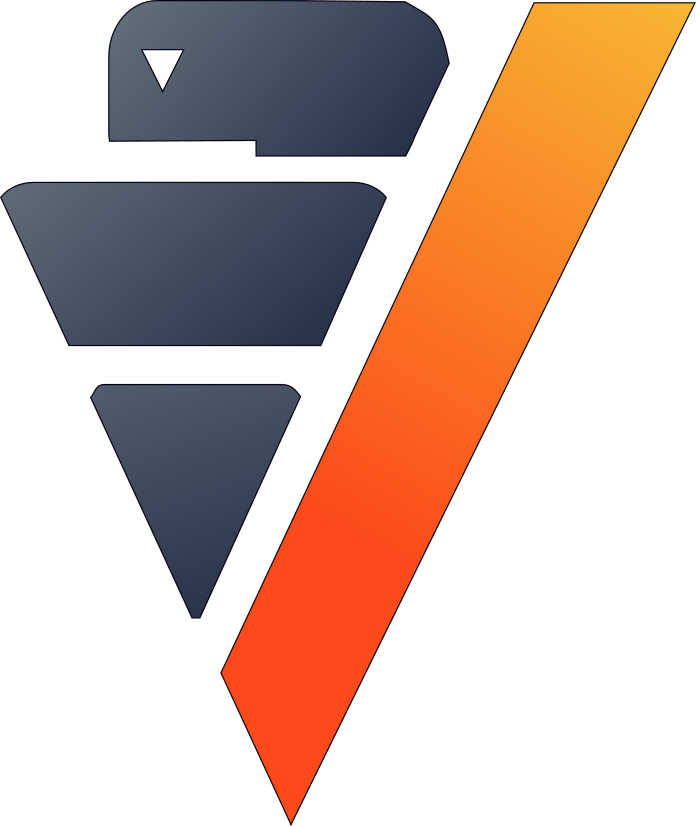

In [37]:
teams_kpi.search(conditions = [teams_kpi["fifa_rank"] == 0],
                 usecols = ["team1", "fifa_rank"],
                 order_by = ["fifa_rank"]).head(10)

A bubble plot will let us visualize the differences in strength between each confederation.

We can see the strongest group at the top right of the graphic and weakest teams at the bottom left. Some teams may be very good in their location but very bad in World Tournaments. They are mainly at the bottom right of the graph.

<AxesSubplot:xlabel='"Percent_Victory_Continental_Tournament"', ylabel='"Percent_Victory_World_Tournament"'>

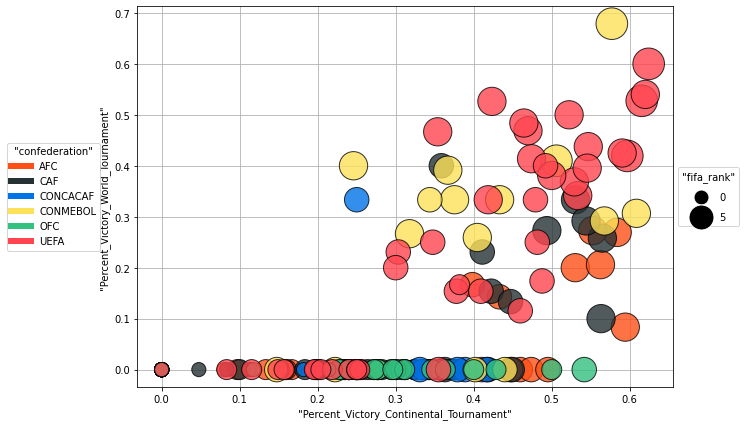

In [38]:
teams_kpi.bubble(["Percent_Victory_Continental_Tournament", 
                  "Percent_Victory_World_Tournament"],
                  size_bubble_col = "fifa_rank",
                  catcol = "confederation")

We can also look at the Percent of Victory by rank to confirm our hypothesis.

<AxesSubplot:xlabel='"Percent_Victory_Continental_Tournament"', ylabel='"Percent_Victory_World_Tournament"'>

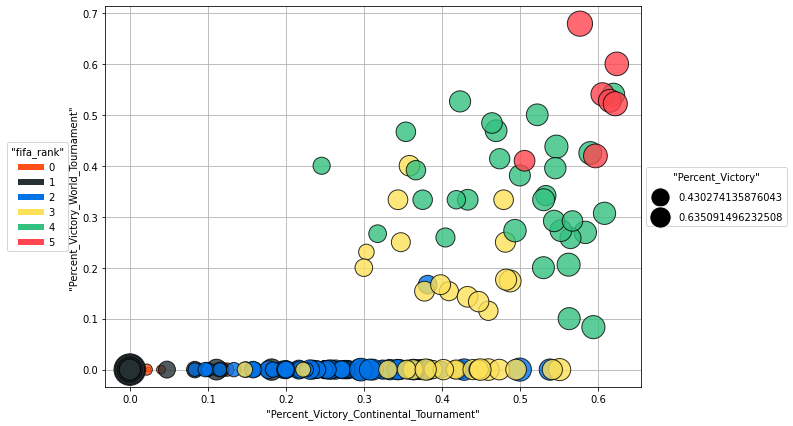

In [39]:
teams_kpi.bubble(["Percent_Victory_Continental_Tournament", 
                  "Percent_Victory_World_Tournament"],
                  size_bubble_col = "Percent_Victory",
                  catcol = "fifa_rank")

A box plot can also show us the differences in skill between teams. We can look at rank 1, where the percent of victory is high because of the confederation.

Note that the best team in a weaker confederation might not be particularly strong, but still have a high Percent of Victory.

<AxesSubplot:xlabel='"fifa_rank"', ylabel='"Percent_Victory"'>

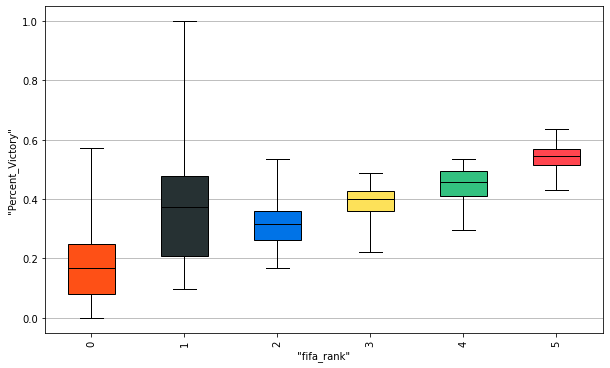

In [40]:
teams_kpi["Percent_Victory"].boxplot(by = "fifa_rank")

Let's export the KPIs to our Vertica database.

,Abcteam1Varchar(64),"123Number_Games_World_TournamentNumeric(34,15)","123Numeric(34,15)",123Percent_Victory_World_TournamentFloat,123Float,123Percent_Victory_HomeFloat,123Percent_Victory_AwayFloat,123Percent_VictoryFloat,123Percent_DrawFloat,123Avg_goalsFloat,123Avg_goals_concededFloat,123nb_World_CupInt,"123nb_Continental_CupNumeric(34,15)",AbcconfederationVarchar(8),123Word_Cup_VictoryInt,123fifa_rankInt
1,Abkhazia,0.0,,0.0,,0.0,0.166666666666667,0.166666666666667,0.5,1.0,1.5,0,0.0,OFC,0,0
2,Afghanistan,0.0,,0.0,,0.4,0.295774647887324,0.284090909090909,0.204545454545455,1.07954545454545,2.05681818181818,0,0.0,AFC,0,2
3,Albania,0.0,,0.0,,0.404255319148936,0.173076923076923,0.23972602739726,0.222602739726027,0.900684931506849,1.5958904109589,0,0.0,UEFA,0,2
4,Alderney,0.0,,0.0,,0.0,0.0833333333333333,0.0833333333333333,0.0,0.583333333333333,4.33333333333333,0,0.0,OFC,0,0
5,Algeria,0.094890510948905,,0.230769230769231,,0.580645161290323,0.31638418079096,0.415217391304348,0.280434782608696,1.35434782608696,1.0304347826087,0,0.125,CAF,0,3
6,American Samoa,0.0,,0.0,,0.0,0.114285714285714,0.0930232558139535,0.0232558139534884,0.627906976744186,6.44186046511628,0,0.0,OFC,0,0
7,Andalusia,0.0,,0.0,,0.636363636363636,0.0,0.636363636363636,0.363636363636364,2.0,0.818181818181818,0,0.0,OFC,0,1
8,Andorra,0.0,,0.0,,0.0571428571428571,0.0,0.0229007633587786,0.0763358778625954,0.282442748091603,2.82442748091603,0,0.0,UEFA,0,0
9,Angola,0.021897810218978,,0.0,,0.5625,0.253521126760563,0.352750809061489,0.352750809061489,1.1747572815534,1.042071197411,0,0.0,CAF,0,2
10,Anguilla,0.0,,0.0,,0.0,0.09375,0.0625,0.0625,0.666666666666667,4.04166666666667,0,0.0,OFC,0,0

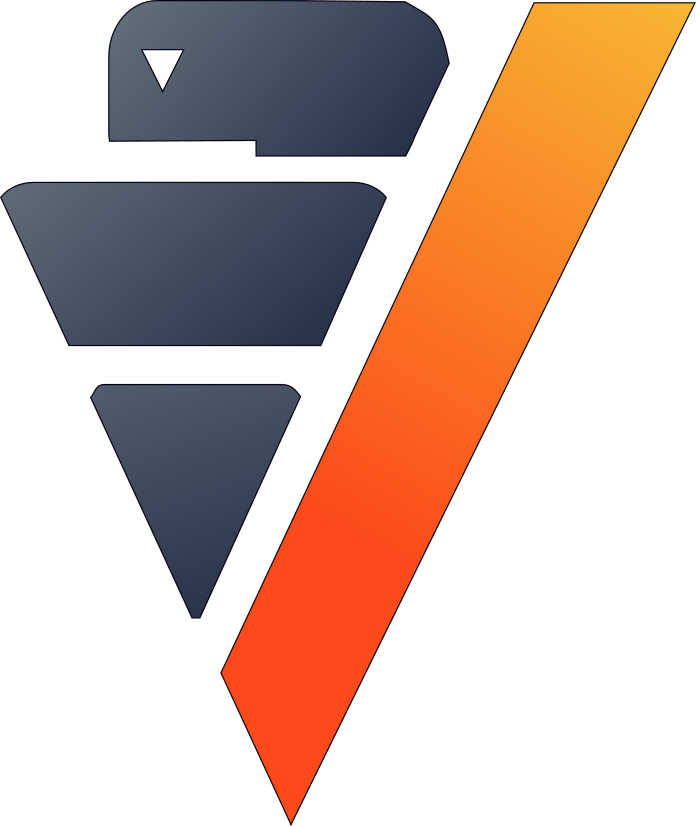

In [41]:
vp.drop("team_kpi", relation_type = "table")
teams_kpi.to_db(name = "team_kpi",
                relation_type = "table",
                inplace = True)

## Features Engineering

Many very interesting features can be to use to evaluate each team. Moving windows of the previous games can drastically improve our model.

Since a team can by a home or away team, we'll intervert the away and home teams. By using this technique, we will never get twice the same game and we will get the proper moving windows.

In [42]:
football = vp.vDataFrame("football_clean")
football["home_team"].rename("team1")
football["home_score"].rename("team1_score")
football["away_team"].rename("team2")
football["away_score"].rename("team2_score")
# will be to use to filter the data after the features engineering
football["match_sample"] = "1"

football2 = vp.vDataFrame("football_clean")
football2["home_team"].rename("team2")
football2["home_score"].rename("team2_score")
football2["away_team"].rename("team1")
football2["away_score"].rename("team1_score")
# will be to use to filter the data after the features engineering
football2["match_sample"] = "2"

# Merging the 2 interverted datasets
all_matchs = football.append(football2)

Let's add the different KPIs to our dataset.

In [43]:
all_matchs = all_matchs.join(teams_kpi,
                             on = {"team1": "team1"},
                             how = "left",
                             expr2 = ["nb_World_Cup AS nb_World_Cup_1",
                                      "fifa_rank AS fifa_rank_1",
                                      "Avg_goals AS Avg_goals_1",
                                      "Percent_Draw AS Percent_Draw_1",
                                      "Number_Games_World_Tournament AS Number_Games_World_Tournament_1",
                                      "Percent_Victory_World_Tournament AS Percent_Victory_World_Tournament_1",
                                      "Percent_Victory_Away AS Percent_Victory_Away_1",
                                      "Percent_Victory_Continental_Tournament AS Percent_Victory_Continental_Tournament_1",
                                      "confederation AS confederation_1",
                                      "Percent_Victory_Home AS Percent_Victory_Home_1",
                                      "Avg_goals_conceded AS Avg_goals_conceded_1",
                                      "Number_Games_Continental_Tournament AS Number_Games_Continental_Tournament_1",
                                      "nb_Continental_Cup AS nb_Continental_Cup_1",
                                      "Percent_Victory AS Percent_Victory_1"])
all_matchs = all_matchs.join(teams_kpi,
                             on = {"team2": "team1"},
                             how = "left",
                             expr2 = ["nb_World_Cup AS nb_World_Cup_2",
                                      "fifa_rank AS fifa_rank_2",
                                      "Avg_goals AS Avg_goals_2",
                                      "Percent_Draw AS Percent_Draw_2",
                                      "Number_Games_World_Tournament AS Number_Games_World_Tournament_2",
                                      "Percent_Victory_World_Tournament AS Percent_Victory_World_Tournament_2",
                                      "Percent_Victory_Away AS Percent_Victory_Away_2",
                                      "Percent_Victory_Continental_Tournament AS Percent_Victory_Continental_Tournament_2",
                                      "confederation AS confederation_2",
                                      "Percent_Victory_Home AS Percent_Victory_Home_2",
                                      "Avg_goals_conceded AS Avg_goals_conceded_2",
                                      "Number_Games_Continental_Tournament AS Number_Games_Continental_Tournament_2",
                                      "nb_Continental_Cup AS nb_Continental_Cup_2",
                                      "Percent_Victory AS Percent_Victory_2"])

We can add dumies to do aggregations on the different games.

,📅dateDate,AbctournamentVarchar(84),010neutralBoolean,AbccountryVarchar(64),AbccityVarchar(56),Abcteam1Varchar(64),123team1_scoreInteger,Abcteam2Varchar(64),123team2_scoreInteger,123match_sampleInteger,123nb_World_Cup_1Integer,123fifa_rank_1Integer,123Avg_goals_1Float,123Percent_Draw_1Float,"123Number_Games_World_Tournament_1Numeric(34,15)",123Float,123Percent_Victory_Away_1Float,123Float,Abcconfederation_1Varchar(8),123Percent_Victory_Home_1Float,123Avg_goals_conceded_1Float,"123Numeric(34,15)","123nb_Continental_Cup_1Numeric(34,15)",123Percent_Victory_1Float,123nb_World_Cup_2Integer,123fifa_rank_2Integer,123Avg_goals_2Float,123Percent_Draw_2Float,"123Number_Games_World_Tournament_2Numeric(34,15)",123Float,123Percent_Victory_Away_2Float,123Float,Abcconfederation_2Varchar(8),123Percent_Victory_Home_2Float,123Avg_goals_conceded_2Float,"123Numeric(34,15)","123nb_Continental_Cup_2Numeric(34,15)",123Percent_Victory_2Float,123victory_team1Int,123drawInt,123victory_team2Int
1,1872-11-30,Friendly,❌,Scotland,Glasgow,Scotland,0,England,0,1,0,3,1.7503355704698,0.21744966442953,0.167883211678832,,0.394230769230769,,UEFA,0.58477508650519,1.2255033557047,,0.0,0.476510067114094,1,5,2.19937369519833,0.241127348643006,0.452554744525547,,0.530864197530864,,UEFA,0.61878453038674,0.992693110647182,,0.0,0.565762004175365,0,1,0
2,1873-03-08,Friendly,❌,England,London,England,4,Scotland,2,1,1,5,2.19937369519833,0.241127348643006,0.452554744525547,,0.530864197530864,,UEFA,0.61878453038674,0.992693110647182,,0.0,0.565762004175365,0,3,1.7503355704698,0.21744966442953,0.167883211678832,,0.394230769230769,,UEFA,0.58477508650519,1.2255033557047,,0.0,0.476510067114094,1,0,0
3,1874-03-07,Friendly,❌,Scotland,Glasgow,Scotland,2,England,1,1,0,3,1.7503355704698,0.21744966442953,0.167883211678832,,0.394230769230769,,UEFA,0.58477508650519,1.2255033557047,,0.0,0.476510067114094,1,5,2.19937369519833,0.241127348643006,0.452554744525547,,0.530864197530864,,UEFA,0.61878453038674,0.992693110647182,,0.0,0.565762004175365,1,0,0
4,1875-03-06,Friendly,❌,England,London,England,2,Scotland,2,1,1,5,2.19937369519833,0.241127348643006,0.452554744525547,,0.530864197530864,,UEFA,0.61878453038674,0.992693110647182,,0.0,0.565762004175365,0,3,1.7503355704698,0.21744966442953,0.167883211678832,,0.394230769230769,,UEFA,0.58477508650519,1.2255033557047,,0.0,0.476510067114094,0,1,0
5,1876-03-04,Friendly,❌,Scotland,Glasgow,Scotland,3,England,0,1,0,3,1.7503355704698,0.21744966442953,0.167883211678832,,0.394230769230769,,UEFA,0.58477508650519,1.2255033557047,,0.0,0.476510067114094,1,5,2.19937369519833,0.241127348643006,0.452554744525547,,0.530864197530864,,UEFA,0.61878453038674,0.992693110647182,,0.0,0.565762004175365,1,0,0
6,1876-03-25,Friendly,❌,Scotland,Glasgow,Scotland,4,Wales,0,1,0,3,1.7503355704698,0.21744966442953,0.167883211678832,,0.394230769230769,,UEFA,0.58477508650519,1.2255033557047,,0.0,0.476510067114094,0,3,1.25324675324675,0.212662337662338,0.036496350364964,,0.265151515151515,,UEFA,0.367088607594937,1.69318181818182,,0.0,0.310064935064935,1,0,0
7,1877-03-03,Friendly,❌,England,London,England,1,Scotland,3,1,1,5,2.19937369519833,0.241127348643006,0.452554744525547,,0.530864197530864,,UEFA,0.61878453038674,0.992693110647182,,0.0,0.565762004175365,0,3,1.7503355704698,0.21744966442953,0.167883211678832,,0.394230769230769,,UEFA,0.58477508650519,1.2255033557047,,0.0,0.476510067114094,0,0,1
8,1877-03-05,Friendly,❌,Wales,Wrexham,Wales,0,Scotland,2,1,0,3,1.25324675324675,0.212662337662338,0.036496350364964,,0.265151515151515,,UEFA,0.367088607594937,1.69318181818182,,0.0,0.310064935064935,0,3,1.7503355704698,0.21744966442953,0.167883211678832,,0.394230769230769,,UEFA,0.58477508650519,1.2255033557047,,0.0,0.476510067114094,0,0,1
9,1878-03-02,Friendly,❌,Scotland,Glasgow,Scotland,7,England,2,1,0,3,1.7503355704698,0.21744966442953,0.167883211678832,,0.394230769230769,,UEFA,0.58477508650519,1.2255033557047,,0.0,0.476510067114094,1,5,2.19937369519833,0.241127348643006,0.452554744525547,,0.53
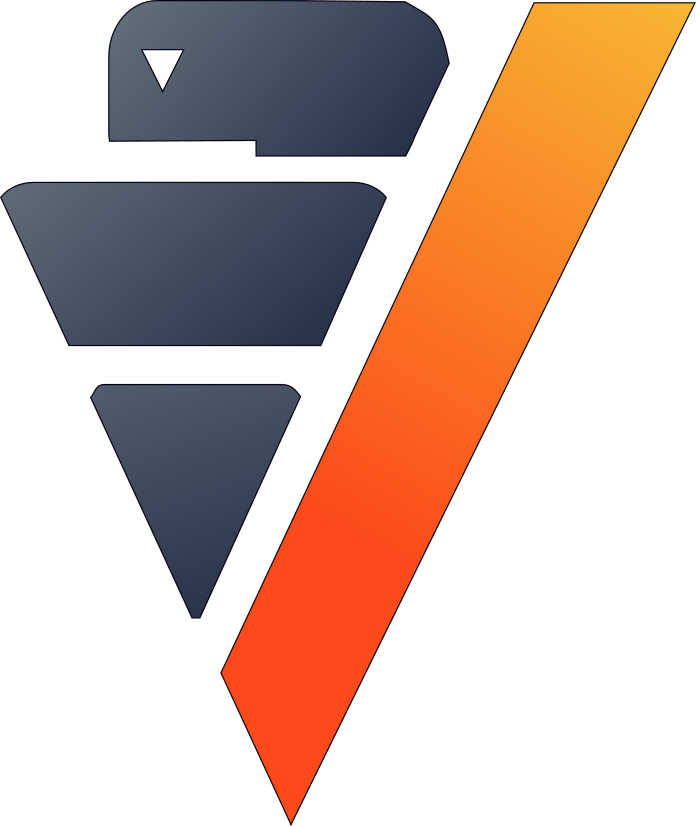

In [44]:
all_matchs["victory_team1"] = all_matchs["team1_score"] > all_matchs["team2_score"]
all_matchs["victory_team1"].astype("int")
all_matchs["draw"] = all_matchs["team1_score"] == all_matchs["team2_score"]
all_matchs["draw"].astype("int")
all_matchs["victory_team2"] = all_matchs["team1_score"] < all_matchs["team2_score"]
all_matchs["victory_team2"].astype("int")

Let's use moving windows to compute some additional features.

<b>The teams' performance in their recent games:</b>

,📅dateDate,AbctournamentVarchar(84),010neutralBoolean,AbccountryVarchar(64),AbccityVarchar(56),Abcteam1Varchar(64),123team1_scoreInteger,Abcteam2Varchar(64),123team2_scoreInteger,123match_sampleInteger,123nb_World_Cup_1Integer,123fifa_rank_1Integer,123Avg_goals_1Float,123Percent_Draw_1Float,"123Number_Games_World_Tournament_1Numeric(34,15)",123Float,123Percent_Victory_Away_1Float,123Float,Abcconfederation_1Varchar(8),123Percent_Victory_Home_1Float,123Avg_goals_conceded_1Float,"123Numeric(34,15)","123nb_Continental_Cup_1Numeric(34,15)",123Percent_Victory_1Float,123nb_World_Cup_2Integer,123fifa_rank_2Integer,123Avg_goals_2Float,123Percent_Draw_2Float,"123Number_Games_World_Tournament_2Numeric(34,15)",123Float,123Percent_Victory_Away_2Float,123Float,Abcconfederation_2Varchar(8),123Percent_Victory_Home_2Float,123Avg_goals_conceded_2Float,"123Numeric(34,15)","123nb_Continental_Cup_2Numeric(34,15)",123Percent_Victory_2Float,123victory_team1Int,123drawInt,123victory_team2Int,123avg_victory_team1_1_10Float,123avg_victory_team1_1_3Float,123avg_draw_team1_1_5Float,123avg_victory_team2_1_10Float,123avg_victory_team2_1_3Float,123avg_draw_team2_1_5Float
1,2012-10-21,Friendly,❌,Azerbaijan,Stepanakert,Artsakh,3,Abkhazia,0,1,0,1,3.0,0.0,0.0,,0.0,,OFC,1.0,0.0,,0.0,1.0,0,0,1.0,0.5,0.0,,0.166666666666667,,OFC,0.0,1.5,,0.0,0.166666666666667,1,0,0,[null],[null],[null],[null],[null],[null]
2,2014-06-01,CONIFA World Football Cup,✅,Sweden,Östersund,Occitania,1,Abkhazia,1,2,0,0,1.25,0.166666666666667,0.0,,0.3,,OFC,0.0,1.83333333333333,,0.0,0.25,0,0,1.0,0.5,0.0,,0.166666666666667,,OFC,0.0,1.5,,0.0,0.166666666666667,0,1,0,0.125,0.333333333333333,0.0,0.0,0.0,0.0
3,2014-06-02,CONIFA World Football Cup,❌,Sweden,Östersund,Sápmi,1,Abkhazia,2,1,0,1,4.35714285714286,0.142857142857143,0.0,,0.5,,OFC,0.375,1.71428571428571,,0.0,0.428571428571429,0,0,1.0,0.5,0.0,,0.166666666666667,,OFC,0.0,1.5,,0.0,0.166666666666667,0,0,1,0.4,0.0,0.2,0.0,0.0,0.5
4,2014-06-04,CONIFA World Football Cup,✅,Sweden,Östersund,South Ossetia,0,Abkhazia,0,2,0,0,0.666666666666667,0.333333333333333,0.0,,0.0,,OFC,0.0,2.33333333333333,,0.0,0.0,0,0,1.0,0.5,0.0,,0.166666666666667,,OFC,0.0,1.5,,0.0,0.166666666666667,0,1,0,0.0,0.0,0.0,0.333333333333333,0.333333333333333,0.333333333333333
5,2014-06-05,CONIFA World Football Cup,✅,Sweden,Östersund,Padania,3,Abkhazia,3,1,0,1,2.5,0.125,0.0,,0.833333333333333,,OFC,1.0,0.5625,,0.0,0.875,0,0,1.0,0.5,0.0,,0.166666666666667,,OFC,0.0,1.5,,0.0,0.166666666666667,0,1,0,1.0,1.0,0.0,0.25,0.333333333333333,0.5
6,2014-06-07,CONIFA World Football Cup,✅,Sweden,Östersund,Occitania,1,Abkhazia,0,2,0,0,1.25,0.166666666666667,0.0,,0.3,,OFC,0.0,1.83333333333333,,0.0,0.25,0,0,1.0,0.5,0.0,,0.166666666666667,,OFC,0.0,1.5,,0.0,0.166666666666667,1,0,0,0.2,0.333333333333333,0.4,0.2,0.333333333333333,0.6
7,2016-05-29,CONIFA World Football Cup,❌,Georgia,Suhkumi,Chagos Islands,0,Abkhazia,9,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],0,0,1.0,0.5,0.0,,0.166666666666667,,OFC,0.0,1.5,,0.0,0.166666666666667,0,0,1,[null],[null],[null],0.166666666666667,0.0,0.6
8,2016-05-31,CONIFA World Football Cup,❌,Georgia,Suhkumi,Western Armenia,0,Abkhazia,1,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],0,0,1.0,0.5,0.0,,0.166666666666667,,OFC,0.0,1.5,,0.0,0.166666666666667,0,0,1,[null],[null],[null],0.285714285714286,0.333333333333333,0.4
9,2016-06-01,CONIFA World Football Cup,❌,Georgia,Suhkumi,Sápmi,0,Abkhazia,2,2,0,1,4.35714285714286,0.142857142857143,0.0,,0.5,,OFC,0.375,1.71428571428571,,0.0,0.428571428571429,0,0,1.0,0.5,0.0,,0.166666666666667,,OFC,0.0,1.5,,0.0,0.166666666666667,0,0,1,0.3,0.333333333333333,0.2,0.375,0.666666666666667,0.4
10,2016-06-04,CONIFA World Football Cup,❌,Georgia,Suhkumi,Northern Cyprus,0,Abkhazia,2,2,0,1,2.26666666666667,0.0666666666666667,0.0,,0.4,,OFC,0.8,1.2,,0.0,0.533333333333333,0,0,1.0,0.5,0.0,,0.166666666666667,,OFC,0.0,1.5,,0.0,0.166666666666667,0,0,1,0.6,0.666666666666667,0.2,0.444444444444444
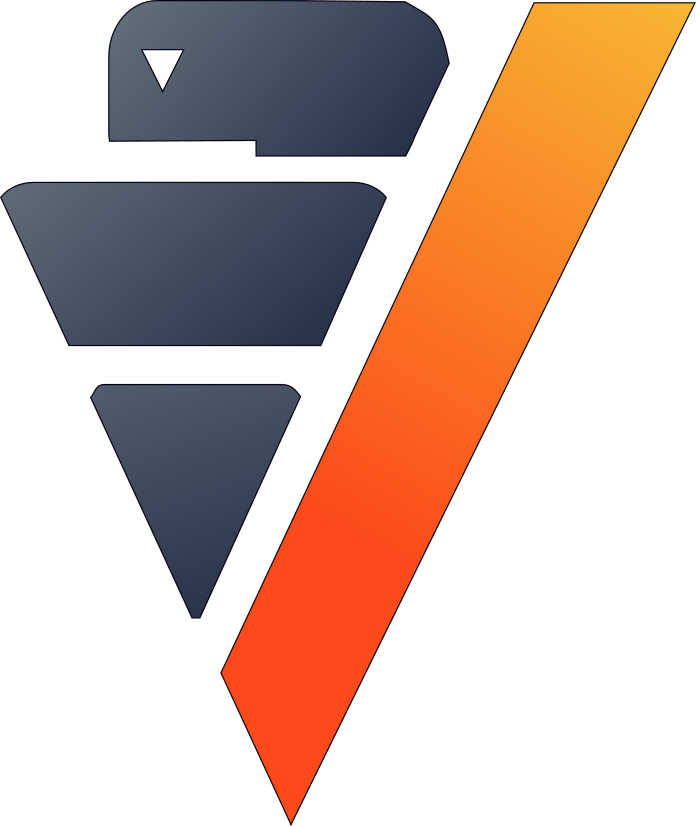

In [45]:
# TEAM 1

# Victory 10 previous games
all_matchs.rolling(func = "avg",
                   window = (-10, -1),
                   columns = "victory_team1",
                   by = ["team1"],
                   order_by = ["date"],
                   name = "avg_victory_team1_1_10",)
# Victory 3 previous games
all_matchs.rolling(func = "avg",
                   window = (-3, -1),
                   columns = "victory_team1",
                   by = ["team1"],
                   order_by = ["date"],
                   name = "avg_victory_team1_1_3",)
# Draw 5 previous games
all_matchs.rolling(func = "avg",
                   window = (-5, -1),
                   columns = "draw",
                   by = ["team1"],
                   order_by = ["date"],
                   name = "avg_draw_team1_1_5",)

# TEAM 2

# Victory 10 previous games
all_matchs.rolling(func = "avg",
                   window = (-10, -1),
                   columns = "victory_team2",
                   by = ["team2"],
                   order_by = ["date"],
                   name = "avg_victory_team2_1_10",)
# Victory 3 previous games
all_matchs.rolling(func = "avg",
                   window = (-3, -1),
                   columns = "victory_team2",
                   by = ["team2"],
                   order_by = ["date"],
                   name = "avg_victory_team2_1_3",)
# Draw 5 previous games
all_matchs.rolling(func = "avg",
                   window = (-5, -1),
                   columns = "draw",
                   by = ["team2"],
                   order_by = ["date"],
                   name = "avg_draw_team2_1_5",)

<b>The teams' performance in the last same tournament</b>

,📅dateDate,AbctournamentVarchar(84),010neutralBoolean,AbccountryVarchar(64),AbccityVarchar(56),Abcteam1Varchar(64),123team1_scoreInteger,Abcteam2Varchar(64),123team2_scoreInteger,123match_sampleInteger,123nb_World_Cup_1Integer,123fifa_rank_1Integer,123Avg_goals_1Float,123Percent_Draw_1Float,"123Number_Games_World_Tournament_1Numeric(34,15)",123Float,123Percent_Victory_Away_1Float,123Float,Abcconfederation_1Varchar(8),123Percent_Victory_Home_1Float,123Avg_goals_conceded_1Float,"123Numeric(34,15)","123nb_Continental_Cup_1Numeric(34,15)",123Percent_Victory_1Float,123nb_World_Cup_2Integer,...,"123Number_Games_World_Tournament_2Numeric(34,15)",123Float,123Percent_Victory_Away_2Float,123Float,Abcconfederation_2Varchar(8),123Percent_Victory_Home_2Float,123Avg_goals_conceded_2Float,"123Numeric(34,15)","123nb_Continental_Cup_2Numeric(34,15)",123Percent_Victory_2Float,123victory_team1Int,123drawInt,123victory_team2Int,123avg_victory_team1_1_10Float,123avg_victory_team1_1_3Float,123avg_draw_team1_1_5Float,123avg_victory_team2_1_10Float,123avg_victory_team2_1_3Float,123avg_draw_team2_1_5Float,123Float,123Float,123Float,123Float,123Float,123Float
1,2010-10-29,ABCS Tournament,❌,Curaçao,Willemstad,Curaçao,3,Aruba,0,1,0,2,1.54785478547855,0.267326732673267,0.0,,0.294444444444444,,CONCACAF,0.666666666666667,1.67656765676568,,0.0,0.356435643564356,0,...,0.0,,0.0847457627118644,,OFC,0.333333333333333,2.40740740740741,,0.0,0.185185185185185,1,0,0,0.1,0.0,0.4,0.0,0.0,0.2,,,,,,
2,2010-10-31,ABCS Tournament,✅,Curaçao,Willemstad,Bonaire,3,Aruba,3,2,0,0,1.61538461538462,0.153846153846154,0.0,,0.307692307692308,,OFC,0.0,3.38461538461538,,0.0,0.307692307692308,0,...,0.0,,0.0847457627118644,,OFC,0.333333333333333,2.40740740740741,,0.0,0.185185185185185,0,1,0,0.0,0.0,0.0,0.0,0.0,0.2,,,,,,
3,2011-12-02,ABCS Tournament,❌,Suriname,Paramaribo,Suriname,0,Aruba,0,1,0,2,1.93313069908815,0.237082066869301,0.0,,0.351851851851852,,OFC,0.632075471698113,1.45288753799392,,0.0,0.434650455927052,0,...,0.0,,0.0847457627118644,,OFC,0.333333333333333,2.40740740740741,,0.0,0.185185185185185,0,1,0,0.4,0.0,0.2,0.1,0.333333333333333,0.2,,,,,,
4,2011-12-04,ABCS Tournament,✅,Suriname,Paramaribo,Bonaire,2,Aruba,2,1,0,0,1.61538461538462,0.153846153846154,0.0,,0.307692307692308,,OFC,0.0,3.38461538461538,,0.0,0.307692307692308,0,...,0.0,,0.0847457627118644,,OFC,0.333333333333333,2.40740740740741,,0.0,0.185185185185185,0,1,0,0.333333333333333,0.333333333333333,0.333333333333333,0.1,0.333333333333333,0.4,,,,,,
5,2012-07-13,ABCS Tournament,❌,Aruba,Oranjestad,Curaçao,2,Aruba,3,2,0,2,1.54785478547855,0.267326732673267,0.0,,0.294444444444444,,CONCACAF,0.666666666666667,1.67656765676568,,0.0,0.356435643564356,0,...,0.0,,0.0847457627118644,,OFC,0.333333333333333,2.40740740740741,,0.0,0.185185185185185,0,0,1,0.2,0.333333333333333,0.2,0.1,0.0,0.6,,,,,,
6,2012-07-15,ABCS Tournament,❌,Aruba,Oranjestad,Suriname,0,Aruba,1,2,0,2,1.93313069908815,0.237082066869301,0.0,,0.351851851851852,,OFC,0.632075471698113,1.45288753799392,,0.0,0.434650455927052,0,...,0.0,,0.0847457627118644,,OFC,0.333333333333333,2.40740740740741,,0.0,0.185185185185185,0,0,1,0.4,0.666666666666667,0.2,0.2,0.333333333333333,0.4,,,,,,
7,2013-11-14,ABCS Tournament,❌,Curaçao,Willemstad,Curaçao,2,Aruba,0,1,0,2,1.54785478547855,0.267326732673267,0.0,,0.294444444444444,,CONCACAF,0.666666666666667,1.67656765676568,,0.0,0.356435643564356,0,...,0.0,,0.0847457627118644,,OFC,0.333333333333333,2.40740740740741,,0.0,0.185185185185185,1,0,0,0.3,0.0,0.0,0.3,0.0,0.2,,,,,,
8,2013-11-16,ABCS Tournament,✅,Curaçao,Willemstad,Bonaire,2,Aruba,1,2,0,0,1.61538461538462,0.153846153846154,0.0,,0.307692307692308,,OFC,0.0,3.38461538461538,,0.0,0.307692307692308,0,...,0.0,,0.0847457627118644,,OFC,0.333333333333333,2.40740740740741,,0.0,0.185185185185185,1,0,0,0.142857142857143,0.0,0.2,0.3,0.0,0.2,,,,,,
9,2015-01-30,ABCS Tournament,✅,Suriname,Paramaribo,Curaçao,0,Aruba,0,1,0,2,1.54785478547855,0.267326732673267,0.0,,0.294444444444444,,CONCACAF,0.666666666666
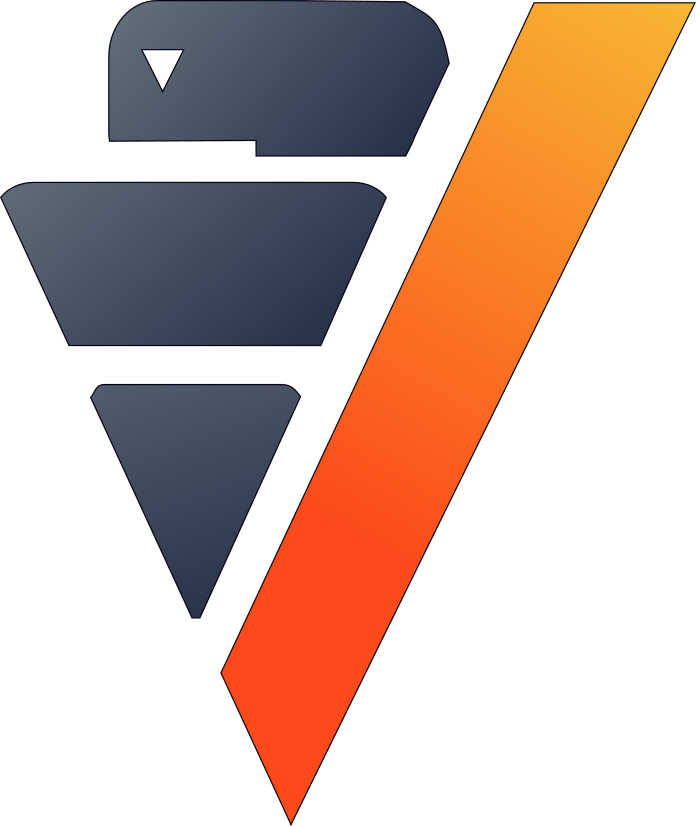

In [46]:
# TEAM 1

# Victory 10 previous games
all_matchs.rolling(func = "avg",
                   window = (-10, -1),
                   columns = "victory_team1",
                   by = ["team1", "tournament"],
                   order_by = ["date"],
                   name = "avg_victory_same_tournament_team1_1_10",)
# Victory 3 previous games
all_matchs.rolling(func = "avg",
                   window = (-3, -1),
                   columns = "victory_team1",
                   by = ["team1", "tournament"],
                   order_by = ["date"],
                   name = "avg_victory_same_tournament_team1_1_3",)
# Draw 5 previous games
all_matchs.rolling(func = "avg",
                   window = (-5, -1),
                   columns = "draw",
                   by = ["team1", "tournament"],
                   order_by = ["date"],
                   name = "avg_draw_same_tournament_team1_1_5",)

# TEAM 2

# Victory 10 previous games
all_matchs.rolling(func = "avg",
                   window = (-10, -1),
                   columns = "victory_team2",
                   by = ["team2", "tournament"],
                   order_by = ["date"],
                   name = "avg_victory_same_tournament_team2_1_10",)
# Victory 3 previous games
all_matchs.rolling(func = "avg",
                   window = (-3, -1),
                   columns = "victory_team2",
                   by = ["team2", "tournament"],
                   order_by = ["date"],
                   name = "avg_victory_same_tournament_team2_1_3",)
# Draw 5 previous games
all_matchs.rolling(func = "avg",
                   window = (-5, -1),
                   columns = "draw",
                   by = ["team2", "tournament"],
                   order_by = ["date"],
                   name = "avg_draw_same_tournament_team2_1_5",)

<b>Direct Confrontation</b>

,📅dateDate,AbctournamentVarchar(84),010neutralBoolean,AbccountryVarchar(64),AbccityVarchar(56),Abcteam1Varchar(64),123team1_scoreInteger,Abcteam2Varchar(64),123team2_scoreInteger,123match_sampleInteger,123nb_World_Cup_1Integer,123fifa_rank_1Integer,123Avg_goals_1Float,123Percent_Draw_1Float,"123Number_Games_World_Tournament_1Numeric(34,15)",123Float,123Percent_Victory_Away_1Float,123Float,Abcconfederation_1Varchar(8),123Percent_Victory_Home_1Float,123Avg_goals_conceded_1Float,"123Numeric(34,15)","123nb_Continental_Cup_1Numeric(34,15)",123Percent_Victory_1Float,123nb_World_Cup_2Integer,...,123Float,Abcconfederation_2Varchar(8),123Percent_Victory_Home_2Float,123Avg_goals_conceded_2Float,"123Numeric(34,15)","123nb_Continental_Cup_2Numeric(34,15)",123Percent_Victory_2Float,123victory_team1Int,123drawInt,123victory_team2Int,123avg_victory_team1_1_10Float,123avg_victory_team1_1_3Float,123avg_draw_team1_1_5Float,123avg_victory_team2_1_10Float,123avg_victory_team2_1_3Float,123avg_draw_team2_1_5Float,123Float,123Float,123Float,123Float,123Float,123Float,123avg_victory_direct_team1_1_5Float,123avg_victory_direct_team1_1_3Float,123avg_draw_direct_team1_1_5Float
1,2010-10-29,ABCS Tournament,❌,Curaçao,Willemstad,Curaçao,3,Aruba,0,1,0,2,1.54785478547855,0.267326732673267,0.0,,0.294444444444444,,CONCACAF,0.666666666666667,1.67656765676568,,0.0,0.356435643564356,0,...,,OFC,0.333333333333333,2.40740740740741,,0.0,0.185185185185185,1,0,0,0.1,0.0,0.4,0.0,0.0,0.2,,,,,,,0.6,0.666666666666667,0.2
2,2010-10-31,ABCS Tournament,✅,Curaçao,Willemstad,Bonaire,3,Aruba,3,2,0,0,1.61538461538462,0.153846153846154,0.0,,0.307692307692308,,OFC,0.0,3.38461538461538,,0.0,0.307692307692308,0,...,,OFC,0.333333333333333,2.40740740740741,,0.0,0.185185185185185,0,1,0,0.0,0.0,0.0,0.0,0.0,0.2,,,,,,,[null],[null],[null]
3,2011-12-02,ABCS Tournament,❌,Suriname,Paramaribo,Suriname,0,Aruba,0,1,0,2,1.93313069908815,0.237082066869301,0.0,,0.351851851851852,,OFC,0.632075471698113,1.45288753799392,,0.0,0.434650455927052,0,...,,OFC,0.333333333333333,2.40740740740741,,0.0,0.185185185185185,0,1,0,0.4,0.0,0.2,0.1,0.333333333333333,0.2,,,,,,,1.0,1.0,0.0
4,2011-12-04,ABCS Tournament,✅,Suriname,Paramaribo,Bonaire,2,Aruba,2,1,0,0,1.61538461538462,0.153846153846154,0.0,,0.307692307692308,,OFC,0.0,3.38461538461538,,0.0,0.307692307692308,0,...,,OFC,0.333333333333333,2.40740740740741,,0.0,0.185185185185185,0,1,0,0.333333333333333,0.333333333333333,0.333333333333333,0.1,0.333333333333333,0.4,,,,,,,0.0,0.0,1.0
5,2012-07-13,ABCS Tournament,❌,Aruba,Oranjestad,Curaçao,2,Aruba,3,2,0,2,1.54785478547855,0.267326732673267,0.0,,0.294444444444444,,CONCACAF,0.666666666666667,1.67656765676568,,0.0,0.356435643564356,0,...,,OFC,0.333333333333333,2.40740740740741,,0.0,0.185185185185185,0,0,1,0.2,0.333333333333333,0.2,0.1,0.0,0.6,,,,,,,0.6,0.666666666666667,0.2
6,2012-07-15,ABCS Tournament,❌,Aruba,Oranjestad,Suriname,0,Aruba,1,2,0,2,1.93313069908815,0.237082066869301,0.0,,0.351851851851852,,OFC,0.632075471698113,1.45288753799392,,0.0,0.434650455927052,0,...,,OFC,0.333333333333333,2.40740740740741,,0.0,0.185185185185185,0,0,1,0.4,0.666666666666667,0.2,0.2,0.333333333333333,0.4,,,,,,,0.8,0.666666666666667,0.2
7,2013-11-14,ABCS Tournament,❌,Curaçao,Willemstad,Curaçao,2,Aruba,0,1,0,2,1.54785478547855,0.267326732673267,0.0,,0.294444444444444,,CONCACAF,0.666666666666667,1.67656765676568,,0.0,0.356435643564356,0,...,,OFC,0.333333333333333,2.40740740740741,,0.0,0.185185185185185,1,0,0,0.3,0.0,0.0,0.3,0.0,0.2,,,,,,,0.6,0.333333333333333,0.2
8,2013-11-16,ABCS Tournament,✅,Curaçao,Willemstad,Bonaire,2,Aruba,1,2,0,0,1.61538461538462,0.153846153846154,0.0,,0.307692307692308,,OFC,0.0,3.38461538461538,,0.0,0.307692307692308,0,...,,OFC,0.333333333333333,2.40740740740741,,0.0,0.185185185185185,1,0,0,0.142857142857143,0.0,0.2,0.3,0.0,0.2,,,,,,,0.0,0.0,1.0
9,2015-01-30,ABCS Tournament,✅,Suriname,Paramaribo,Curaçao,0,Aruba,0,1,0,2,1.54785478547855,0.267326732673267,0.0,,0.294444444444444,,CONCACAF,0.666666666666667,1.67656765
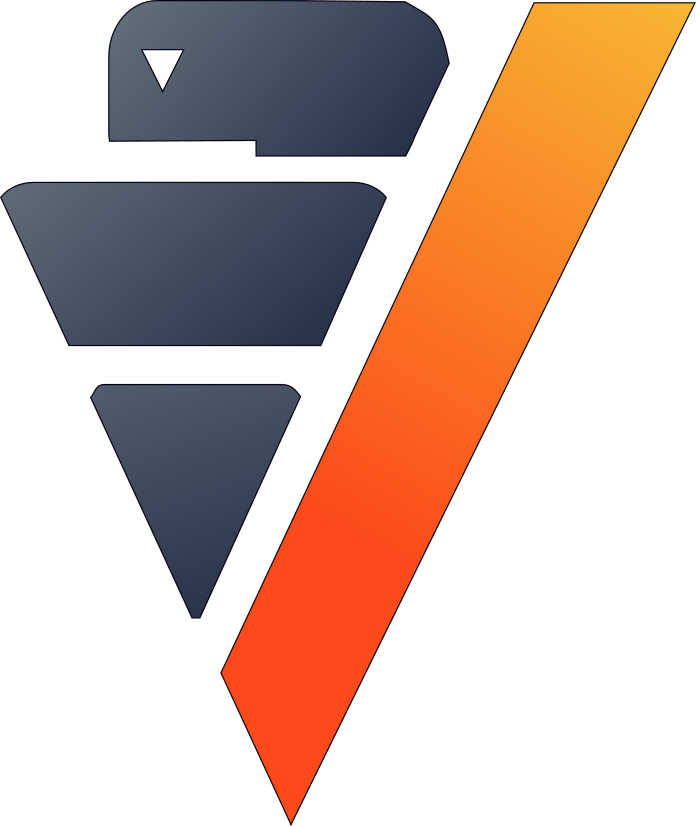

In [47]:
# Victory 5 previous games
all_matchs.rolling(func = "avg",
                   window = (-5, -1),
                   columns = "victory_team1",
                   by = ["team1", "team2"],
                   order_by = ["date"],
                   name = "avg_victory_direct_team1_1_5",)
# Victory 3 previous games
all_matchs.rolling(func = "avg",
                   window = (-3, -1),
                   columns = "victory_team1",
                   by = ["team1", "team2"],
                   order_by = ["date"],
                   name = "avg_victory_direct_team1_1_3",)
# Draw 5 previous games
all_matchs.rolling(func = "avg",
                   window = (-5, -1),
                   columns = "draw",
                   by = ["team1", "team2"],
                   order_by = ["date"],
                   name = "avg_draw_direct_team1_1_5",)

<b>Games against an opponents with the same rank</b>

,📅dateDate,AbctournamentVarchar(84),010neutralBoolean,AbccountryVarchar(64),AbccityVarchar(56),Abcteam1Varchar(64),123team1_scoreInteger,Abcteam2Varchar(64),123team2_scoreInteger,123match_sampleInteger,123nb_World_Cup_1Integer,123fifa_rank_1Integer,123Avg_goals_1Float,123Percent_Draw_1Float,"123Number_Games_World_Tournament_1Numeric(34,15)",123Float,123Percent_Victory_Away_1Float,123Float,Abcconfederation_1Varchar(8),123Percent_Victory_Home_1Float,123Avg_goals_conceded_1Float,"123Numeric(34,15)","123nb_Continental_Cup_1Numeric(34,15)",123Percent_Victory_1Float,123nb_World_Cup_2Integer,...,"123Numeric(34,15)","123nb_Continental_Cup_2Numeric(34,15)",123Percent_Victory_2Float,123victory_team1Int,123drawInt,123victory_team2Int,123avg_victory_team1_1_10Float,123avg_victory_team1_1_3Float,123avg_draw_team1_1_5Float,123avg_victory_team2_1_10Float,123avg_victory_team2_1_3Float,123avg_draw_team2_1_5Float,123Float,123Float,123Float,123Float,123Float,123Float,123avg_victory_direct_team1_1_5Float,123avg_victory_direct_team1_1_3Float,123avg_draw_direct_team1_1_5Float,123avg_victory_rank2_team1_1_5Float,123avg_draw_rank2_team1_1_5Float,123avg_victory_rank1_team2_1_5Float,123avg_draw_rank1_team2_1_5Float
1,2016-05-29,CONIFA World Football Cup,❌,Georgia,Suhkumi,Chagos Islands,0,Abkhazia,9,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],0,...,,0.0,0.166666666666667,0,0,1,[null],[null],[null],0.166666666666667,0.0,0.6,,,,,,,[null],[null],[null],[null],[null],[null],[null]
2,2016-05-31,CONIFA World Football Cup,❌,Georgia,Suhkumi,Western Armenia,0,Abkhazia,1,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],0,...,,0.0,0.166666666666667,0,0,1,[null],[null],[null],0.285714285714286,0.333333333333333,0.4,,,,,,,[null],[null],[null],[null],[null],1.0,0.0
3,2016-06-05,CONIFA World Football Cup,❌,Georgia,Suhkumi,Panjab,1,Abkhazia,1,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],0,...,,0.0,0.166666666666667,0,1,0,0.5,0.5,0.0,0.5,1.0,0.0,,,,,,,[null],[null],[null],[null],[null],1.0,0.0
4,2019-06-06,CONIFA European Football Cup,✅,Azerbaijan,Stepanakert,Western Armenia,1,Abkhazia,1,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],0,...,,0.0,0.166666666666667,0,1,0,0.285714285714286,0.666666666666667,0.4,0.4,0.666666666666667,0.4,,,,,,,0.0,0.0,0.0,0.5,0.0,0.666666666666667,0.333333333333333
5,2014-06-01,CONIFA World Football Cup,✅,Sweden,Östersund,Occitania,1,Abkhazia,1,2,0,0,1.25,0.166666666666667,0.0,,0.3,,OFC,0.0,1.83333333333333,,0.0,0.25,0,...,,0.0,0.166666666666667,0,1,0,0.125,0.333333333333333,0.0,0.0,0.0,0.0,,,,,,,[null],[null],[null],0.5,0.0,[null],[null]
6,2014-06-04,CONIFA World Football Cup,✅,Sweden,Östersund,South Ossetia,0,Abkhazia,0,2,0,0,0.666666666666667,0.333333333333333,0.0,,0.0,,OFC,0.0,2.33333333333333,,0.0,0.0,0,...,,0.0,0.166666666666667,0,1,0,0.0,0.0,0.0,0.333333333333333,0.333333333333333,0.333333333333333,,,,,,,[null],[null],[null],[null],[null],0.0,1.0
7,2014-06-07,CONIFA World Football Cup,✅,Sweden,Östersund,Occitania,1,Abkhazia,0,2,0,0,1.25,0.166666666666667,0.0,,0.3,,OFC,0.0,1.83333333333333,,0.0,0.25,0,...,,0.0,0.166666666666667,1,0,0,0.2,0.333333333333333,0.4,0.2,0.333333333333333,0.6,,,,,,,0.0,0.0,1.0,0.333333333333333,0.333333333333333,0.0,1.0
8,2017-06-05,CONIFA European Football Cup,✅,Northern Cyprus,Kyrenia,South Ossetia,1,Abkhazia,2,2,0,0,0.666666666666667,0.333333333333333,0.0,,0.0,,OFC,0.0,2.33333333333333,,0.0,0.0,0,...,,0.0,0.166666666666667,0,0,1,0.0,0.0,0.333333333333333,0.5,0.666666666666667,0.2,,,,,,,0.0,0.0,1.0,0.0,0.5,0.0,0.666666666666667
9,2017-06-10,CONIFA European Football Cup,✅,Northern Cyprus,Kyrenia,Székely Land,3,Abkhazia,1,1,0,0,1.0,0.0,0.0,,0.0,,OFC,0.0,3.0,,0.0,0.0,0,...,,0.0,0.166666666666667,1,0,0,0.285714285714286,0.333333333333333,0.2,0.5,0.333333333333333,0.6,,,,,,,[null],[null],[null],0.666666666666667,0.0,0.25,0.5
10,2018-05-31,CONIFA World Football Cup,✅,Englan
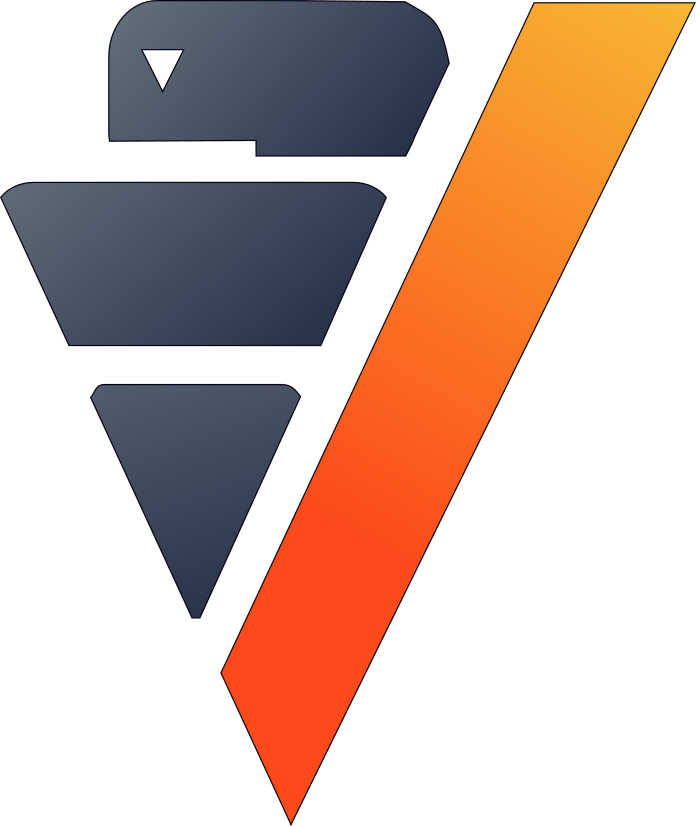

In [48]:
# TEAM 1

# Victory 5 previous games
all_matchs.rolling(func = "avg",
                   window = (-5, -1),
                   columns = "victory_team1",
                   by = ["team1", "fifa_rank_2"],
                   order_by = ["date"],
                   name = "avg_victory_rank2_team1_1_5",)
# Draw 5 previous games
all_matchs.rolling(func = "avg",
                   window = (-5, -1),
                   columns = "draw",
                   by = ["team1", "fifa_rank_2"],
                   order_by = ["date"],
                   name = "avg_draw_rank2_team1_1_5",)

# TEAM 2

# Victory 5 previous games
all_matchs.rolling(func = "avg",
                   window = (-5, -1),
                   columns = "victory_team2",
                   by = ["team2", "fifa_rank_1"],
                   order_by = ["date"],
                   name = "avg_victory_rank1_team2_1_5",)
# Draw 5 previous games
all_matchs.rolling(func = "avg",
                   window = (-5, -1),
                   columns = "draw",
                   by = ["team2", "fifa_rank_1"],
                   order_by = ["date"],
                   name = "avg_draw_rank1_team2_1_5",)

<b>Games between teams with rank 1 and rank 2</b>

,📅dateDate,AbctournamentVarchar(84),010neutralBoolean,AbccountryVarchar(64),AbccityVarchar(56),Abcteam1Varchar(64),123team1_scoreInteger,Abcteam2Varchar(64),123team2_scoreInteger,123match_sampleInteger,123nb_World_Cup_1Integer,123fifa_rank_1Integer,123Avg_goals_1Float,123Percent_Draw_1Float,"123Number_Games_World_Tournament_1Numeric(34,15)",123Float,123Percent_Victory_Away_1Float,123Float,Abcconfederation_1Varchar(8),123Percent_Victory_Home_1Float,123Avg_goals_conceded_1Float,"123Numeric(34,15)","123nb_Continental_Cup_1Numeric(34,15)",123Percent_Victory_1Float,123nb_World_Cup_2Integer,...,123Percent_Victory_2Float,123victory_team1Int,123drawInt,123victory_team2Int,123avg_victory_team1_1_10Float,123avg_victory_team1_1_3Float,123avg_draw_team1_1_5Float,123avg_victory_team2_1_10Float,123avg_victory_team2_1_3Float,123avg_draw_team2_1_5Float,123Float,123Float,123Float,123Float,123Float,123Float,123avg_victory_direct_team1_1_5Float,123avg_victory_direct_team1_1_3Float,123avg_draw_direct_team1_1_5Float,123avg_victory_rank2_team1_1_5Float,123avg_draw_rank2_team1_1_5Float,123avg_victory_rank1_team2_1_5Float,123avg_draw_rank1_team2_1_5Float,123Float,123avg_draw_rank1_rank2_team1_1_5Float
1,2016-08-26,World Unity Cup,❌,England,London,Chagos Islands,3,Barawa,2,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,[null],1,0,0,0.0,0.0,0.0,0.0,0.0,0.0,,,,,,,[null],[null],[null],[null],[null],[null],[null],,[null]
2,2016-08-26,World Unity Cup,❌,England,London,Barawa,2,Chagos Islands,3,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,[null],0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,,,,,,,[null],[null],[null],[null],[null],[null],[null],,0.0
3,2018-04-08,Friendly,❌,England,London,Chagos Islands,1,Barawa,4,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,[null],0,0,1,0.5,0.5,0.0,0.0,0.0,0.0,,,,,,,1.0,1.0,0.0,1.0,0.0,0.0,0.0,,0.0
4,2018-04-08,Friendly,❌,England,London,Barawa,4,Chagos Islands,1,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,[null],1,0,0,0.0,0.0,0.0,0.5,0.5,0.0,,,,,,,0.0,0.0,0.0,0.0,0.0,1.0,0.0,,0.0
5,2018-05-31,CONIFA World Football Cup,✅,England,Carshalton,Western Armenia,0,United Koreans in Japan,0,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,[null],0,1,0,0.0,0.0,0.333333333333333,0.2,0.0,0.4,,,,,,,[null],[null],[null],[null],[null],[null],[null],,0.0
6,2018-05-31,CONIFA World Football Cup,✅,England,Carshalton,United Koreans in Japan,0,Western Armenia,0,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,[null],0,1,0,0.2,0.0,0.4,0.0,0.0,0.333333333333333,,,,,,,[null],[null],[null],[null],[null],[null],[null],,0.2
7,2018-06-07,CONIFA World Football Cup,❌,England,Sutton,Barawa,0,Panjab,5,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,[null],0,0,1,0.5,0.666666666666667,0.0,0.25,0.0,0.25,,,,,,,[null],[null],[null],0.5,0.0,[null],[null],,0.4
8,2018-06-07,CONIFA World Football Cup,❌,England,Sutton,Panjab,5,Barawa,0,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,[null],1,0,0,0.25,0.0,0.25,0.5,0.666666666666667,0.0,,,,,,,[null],[null],[null],[null],[null],0.5,0.0,,0.4
9,2018-06-09,CONIFA World Football Cup,❌,England,Haringey,Barawa,0,Western Armenia,7,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,[null],0,0,1,0.428571428571429,0.333333333333333,0.0,0.0,0.0,0.5,,,,,,,[null],[null],[null],0.333333333333333,0.0,0.0,1.0,,0.4
10,2018-06-09,CONIFA World Football Cup,❌,England,Haringey,Western Armenia,7,Barawa,0,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,[null],1,0,0,0.0,0.0,0.5,0.428571428571429,0.333333333333333,0.0,,,,,,,[null],[null],[null],0.0,1.0,0.333333333333333,0.0,,0.4

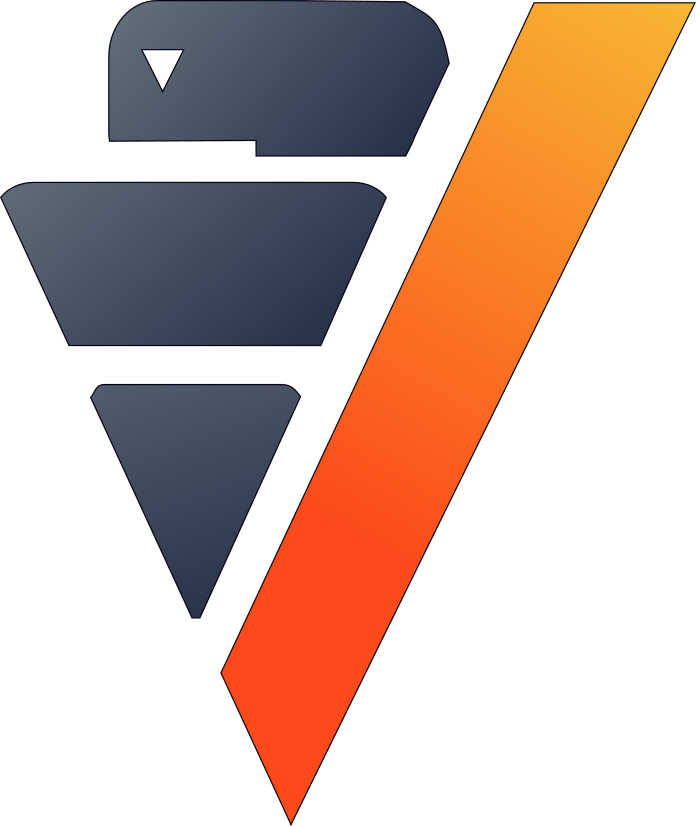

In [49]:
# Victory 5 previous games
all_matchs.rolling(func = "avg",
                   window = (-5, -1),
                   columns = "victory_team1",
                   by = ["fifa_rank_1", "fifa_rank_2"],
                   order_by = ["date"],
                   name = "avg_victory_rank1_rank2_team1_1_5",)
# Draw 5 previous games
all_matchs.rolling(func = "avg",
                   window = (-5, -1),
                   columns = "draw",
                   by = ["fifa_rank_1", "fifa_rank_2"],
                   order_by = ["date"],
                   name = "avg_draw_rank1_rank2_team1_1_5",)

Before we use the 'neutral' variable with our model, we should convert it to an integer.

We need also to create our response column: the outcome of the game.

,📅dateDate,AbctournamentVarchar(84),123neutralInt,AbccountryVarchar(64),AbccityVarchar(56),Abcteam1Varchar(64),123team1_scoreInteger,Abcteam2Varchar(64),123team2_scoreInteger,123match_sampleInteger,123nb_World_Cup_1Integer,123fifa_rank_1Integer,123Avg_goals_1Float,123Percent_Draw_1Float,"123Number_Games_World_Tournament_1Numeric(34,15)",123Float,123Percent_Victory_Away_1Float,123Float,Abcconfederation_1Varchar(8),123Percent_Victory_Home_1Float,123Avg_goals_conceded_1Float,"123Numeric(34,15)","123nb_Continental_Cup_1Numeric(34,15)",123Percent_Victory_1Float,123nb_World_Cup_2Integer,...,123victory_team1Int,123drawInt,123victory_team2Int,123avg_victory_team1_1_10Float,123avg_victory_team1_1_3Float,123avg_draw_team1_1_5Float,123avg_victory_team2_1_10Float,123avg_victory_team2_1_3Float,123avg_draw_team2_1_5Float,123Float,123Float,123Float,123Float,123Float,123Float,123avg_victory_direct_team1_1_5Float,123avg_victory_direct_team1_1_3Float,123avg_draw_direct_team1_1_5Float,123avg_victory_rank2_team1_1_5Float,123avg_draw_rank2_team1_1_5Float,123avg_victory_rank1_team2_1_5Float,123avg_draw_rank1_team2_1_5Float,123Float,123avg_draw_rank1_rank2_team1_1_5Float,AbcresultVarchar(1)
1,2016-08-26,World Unity Cup,0,England,London,Chagos Islands,3,Barawa,2,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,1,0,0,0.0,0.0,0.0,0.0,0.0,0.0,,,,,,,[null],[null],[null],[null],[null],[null],[null],,[null],1
2,2016-08-26,World Unity Cup,0,England,London,Barawa,2,Chagos Islands,3,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,,,,,,,[null],[null],[null],[null],[null],[null],[null],,0.0,2
3,2018-04-08,Friendly,0,England,London,Chagos Islands,1,Barawa,4,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,0,1,0.5,0.5,0.0,0.0,0.0,0.0,,,,,,,1.0,1.0,0.0,1.0,0.0,0.0,0.0,,0.0,2
4,2018-04-08,Friendly,0,England,London,Barawa,4,Chagos Islands,1,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,1,0,0,0.0,0.0,0.0,0.5,0.5,0.0,,,,,,,0.0,0.0,0.0,0.0,0.0,1.0,0.0,,0.0,1
5,2018-05-31,CONIFA World Football Cup,1,England,Carshalton,Western Armenia,0,United Koreans in Japan,0,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,1,0,0.0,0.0,0.333333333333333,0.2,0.0,0.4,,,,,,,[null],[null],[null],[null],[null],[null],[null],,0.0,X
6,2018-05-31,CONIFA World Football Cup,1,England,Carshalton,United Koreans in Japan,0,Western Armenia,0,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,1,0,0.2,0.0,0.4,0.0,0.0,0.333333333333333,,,,,,,[null],[null],[null],[null],[null],[null],[null],,0.2,X
7,2018-06-07,CONIFA World Football Cup,0,England,Sutton,Barawa,0,Panjab,5,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,0,1,0.5,0.666666666666667,0.0,0.25,0.0,0.25,,,,,,,[null],[null],[null],0.5,0.0,[null],[null],,0.4,2
8,2018-06-07,CONIFA World Football Cup,0,England,Sutton,Panjab,5,Barawa,0,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,1,0,0,0.25,0.0,0.25,0.5,0.666666666666667,0.0,,,,,,,[null],[null],[null],[null],[null],0.5,0.0,,0.4,1
9,2018-06-09,CONIFA World Football Cup,0,England,Haringey,Barawa,0,Western Armenia,7,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,0,1,0.428571428571429,0.333333333333333,0.0,0.0,0.0,0.5,,,,,,,[null],[null],[null],0.333333333333333,0.0,0.0,1.0,,0.4,2
10,2018-06-09,CONIFA World Football Cup,0,England,Haringey,Western Armenia,7,Barawa,0,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,1,0,0,0.0,0.0,0.5,0.428571428571429,0.333333333333333,0.0,,,,,,,[null],[null],[null],0.0,1.0,0.333333333333333,0.0,,0.4,1

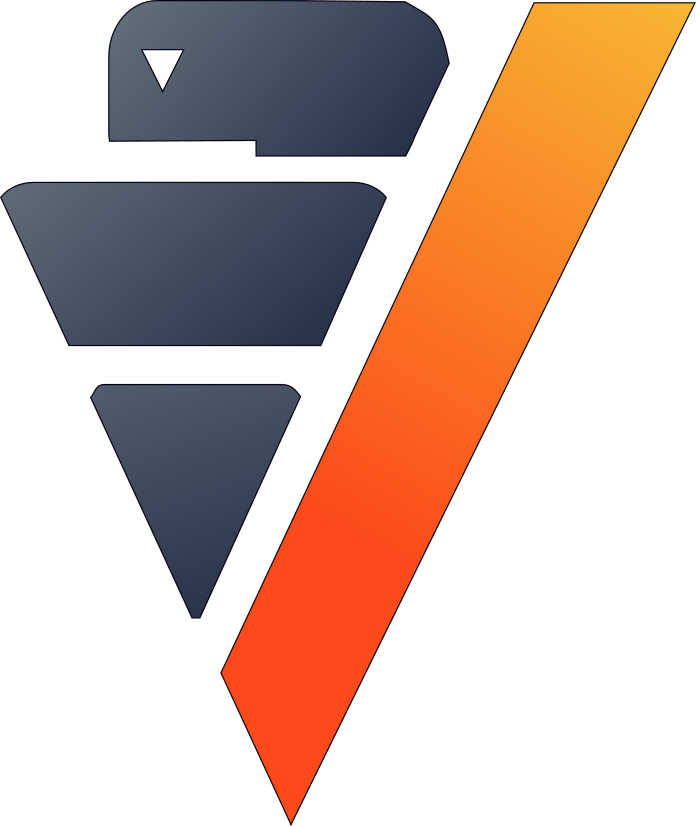

In [50]:
all_matchs["neutral"].astype("int")
all_matchs.case_when("result",
                     all_matchs["team1_score"] > all_matchs["team2_score"], "1",
                     all_matchs["team1_score"] < all_matchs["team2_score"], "2", 
                     "X")

We have some missing values here. This might be because the two teams never played together, the competition was one or both teams' first, etc.

,count
,82818.0
,82818.0
,82818.0
,82818.0
,82818.0
,82818.0
,82818.0
,82818.0
,82818.0
,82818.0

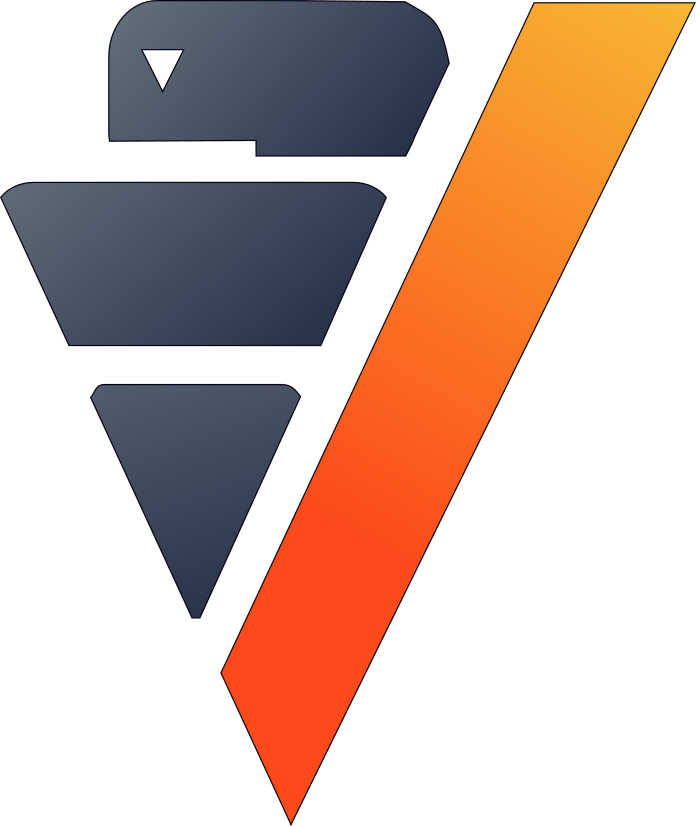

In [51]:
all_matchs.count()

We need to impute these missing values.

1833 elements were filled.
2112 elements were filled.
1833 elements were filled.
1833 elements were filled.
2112 elements were filled.
1833 elements were filled.


,📅dateDate,AbctournamentVarchar(84),123neutralInt,AbccountryVarchar(64),AbccityVarchar(56),Abcteam1Varchar(64),123team1_scoreInteger,Abcteam2Varchar(64),123team2_scoreInteger,123match_sampleInteger,123nb_World_Cup_1Integer,123fifa_rank_1Integer,123Avg_goals_1Float,123Percent_Draw_1Float,"123Number_Games_World_Tournament_1Numeric(34,15)",123Float,123Percent_Victory_Away_1Float,123Float,Abcconfederation_1Varchar(8),123Percent_Victory_Home_1Float,123Avg_goals_conceded_1Float,"123Numeric(34,15)","123nb_Continental_Cup_1Numeric(34,15)",123Percent_Victory_1Float,123nb_World_Cup_2Integer,...,123victory_team1Int,123drawInt,123victory_team2Int,123avg_victory_team1_1_10Float,123avg_victory_team1_1_3Float,123avg_draw_team1_1_5Float,123avg_victory_team2_1_10Float,123avg_victory_team2_1_3Float,123avg_draw_team2_1_5Float,123Float,123Float,123Float,123Float,123Float,123Float,123avg_victory_direct_team1_1_5Float,123avg_victory_direct_team1_1_3Float,123avg_draw_direct_team1_1_5Float,123avg_victory_rank2_team1_1_5Float,123avg_draw_rank2_team1_1_5Float,123avg_victory_rank1_team2_1_5Float,123avg_draw_rank1_team2_1_5Float,123Float,123avg_draw_rank1_rank2_team1_1_5Float,AbcresultVarchar(1)
1,2016-08-26,World Unity Cup,0,England,London,Chagos Islands,3,Barawa,2,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,1,0,0,0.0,0.0,0.0,0.0,0.0,0.0,,,,,,,[null],[null],[null],[null],[null],[null],[null],,[null],1
2,2016-08-26,World Unity Cup,0,England,London,Barawa,2,Chagos Islands,3,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,,,,,,,1.0,1.0,0.0,[null],[null],[null],[null],,0.0,2
3,2018-04-08,Friendly,0,England,London,Chagos Islands,1,Barawa,4,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,0,1,0.5,0.5,0.0,0.0,0.0,0.0,,,,,,,1.0,1.0,0.0,1.0,0.0,0.0,0.0,,0.0,2
4,2018-04-08,Friendly,0,England,London,Barawa,4,Chagos Islands,1,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,1,0,0,0.0,0.0,0.0,0.5,0.5,0.0,,,,,,,0.0,0.0,0.0,0.0,0.0,1.0,0.0,,0.0,1
5,2018-05-31,CONIFA World Football Cup,1,England,Carshalton,Western Armenia,0,United Koreans in Japan,0,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,1,0,0.0,0.0,0.333333333333333,0.2,0.0,0.4,,,,,,,0.5,0.5,0.0,[null],[null],[null],[null],,0.0,X
6,2018-05-31,CONIFA World Football Cup,1,England,Carshalton,United Koreans in Japan,0,Western Armenia,0,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,1,0,0.2,0.0,0.4,0.0,0.0,0.333333333333333,,,,,,,0.4,0.4,0.2,[null],[null],[null],[null],,0.2,X
7,2018-06-07,CONIFA World Football Cup,0,England,Sutton,Barawa,0,Panjab,5,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,0,1,0.5,0.666666666666667,0.0,0.25,0.0,0.25,,,,,,,0.5,0.5,0.0,0.5,0.0,[null],[null],,0.4,2
8,2018-06-07,CONIFA World Football Cup,0,England,Sutton,Panjab,5,Barawa,0,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,1,0,0,0.25,0.0,0.25,0.5,0.666666666666667,0.0,,,,,,,0.2,0.2,0.4,[null],[null],0.5,0.0,,0.4,1
9,2018-06-09,CONIFA World Football Cup,0,England,Haringey,Barawa,0,Western Armenia,7,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,0,1,0.428571428571429,0.333333333333333,0.0,0.0,0.0,0.5,,,,,,,0.333333333333333,0.333333333333333,0.0,0.333333333333333,0.0,0.0,1.0,,0.4,2
10,2018-06-09,CONIFA World Football Cup,0,England,Haringey,Western Armenia,7,Barawa,0,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,1,0,0,0.0,0.0,0.5,0.428571428571429,0.333333333333333,0.0,,,,,,,0.0,0.0,1.0,0.0,1.0,0.333333333333333,0.0,,0.4,1

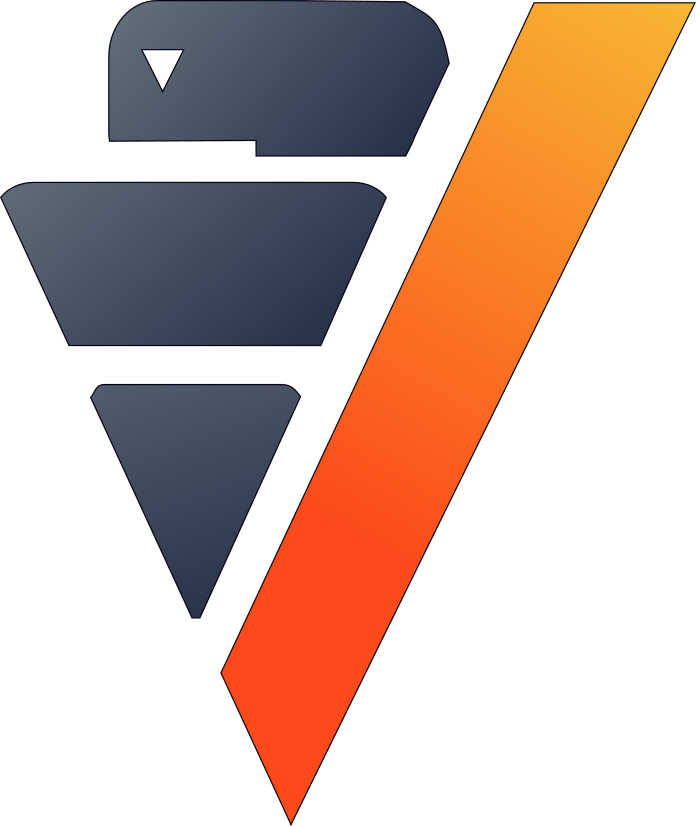

In [52]:
all_matchs["avg_victory_direct_team1_1_5"] = st.coalesce(all_matchs["avg_victory_direct_team1_1_5"],
                                                         all_matchs["avg_victory_rank2_team1_1_5"],
                                                         all_matchs["avg_victory_rank1_rank2_team1_1_5"])
all_matchs["avg_victory_direct_team1_1_3"] = st.coalesce(all_matchs["avg_victory_direct_team1_1_3"],
                                                         all_matchs["avg_victory_rank2_team1_1_5"],
                                                         all_matchs["avg_victory_rank1_rank2_team1_1_5"])
all_matchs["avg_draw_direct_team1_1_5"] = st.coalesce(all_matchs["avg_draw_direct_team1_1_5"],
                                                      all_matchs["avg_draw_rank2_team1_1_5"],
                                                      all_matchs["avg_draw_rank1_rank2_team1_1_5"])
all_matchs["avg_victory_same_tournament_team1_1_10"].fillna(expr = "avg_victory_team1_1_10")
all_matchs["avg_victory_same_tournament_team1_1_3"].fillna(expr = "avg_victory_team1_1_3")
all_matchs["avg_draw_same_tournament_team1_1_5"].fillna(expr = "avg_draw_team1_1_5")
all_matchs["avg_victory_same_tournament_team2_1_10"].fillna(expr = "avg_victory_team2_1_10")
all_matchs["avg_victory_same_tournament_team2_1_3"].fillna(expr = "avg_victory_team2_1_3")
all_matchs["avg_draw_same_tournament_team2_1_5"].fillna(expr = "avg_draw_team2_1_5")

Let's export the result to our Vertica database using the variable 'match_sample' to avoid counting the same game twice.

,📅dateDate,AbctournamentVarchar(84),123neutralInt,AbccountryVarchar(64),AbccityVarchar(56),Abcteam1Varchar(64),123team1_scoreInteger,Abcteam2Varchar(64),123team2_scoreInteger,123match_sampleInteger,123nb_World_Cup_1Integer,123fifa_rank_1Integer,123Avg_goals_1Float,123Percent_Draw_1Float,"123Number_Games_World_Tournament_1Numeric(34,15)",123Float,123Percent_Victory_Away_1Float,123Float,Abcconfederation_1Varchar(8),123Percent_Victory_Home_1Float,123Avg_goals_conceded_1Float,"123Numeric(34,15)","123nb_Continental_Cup_1Numeric(34,15)",123Percent_Victory_1Float,123nb_World_Cup_2Integer,...,123victory_team1Int,123drawInt,123victory_team2Int,123avg_victory_team1_1_10Float,123avg_victory_team1_1_3Float,123avg_draw_team1_1_5Float,123avg_victory_team2_1_10Float,123avg_victory_team2_1_3Float,123avg_draw_team2_1_5Float,123Float,123Float,123Float,123Float,123Float,123Float,123avg_victory_direct_team1_1_5Float,123avg_victory_direct_team1_1_3Float,123avg_draw_direct_team1_1_5Float,123avg_victory_rank2_team1_1_5Float,123avg_draw_rank2_team1_1_5Float,123avg_victory_rank1_team2_1_5Float,123avg_draw_rank1_team2_1_5Float,123Float,123avg_draw_rank1_rank2_team1_1_5Float,AbcresultVarchar(1)
1,2016-08-26,World Unity Cup,0,England,London,Chagos Islands,3,Barawa,2,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,1,0,0,0.0,0.0,0.0,0.0,0.0,0.0,,,,,,,[null],[null],[null],[null],[null],[null],[null],,[null],1
2,2016-08-26,World Unity Cup,0,England,London,Barawa,2,Chagos Islands,3,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,,,,,,,1.0,1.0,0.0,[null],[null],[null],[null],,0.0,2
3,2018-04-08,Friendly,0,England,London,Chagos Islands,1,Barawa,4,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,0,1,0.5,0.5,0.0,0.0,0.0,0.0,,,,,,,1.0,1.0,0.0,1.0,0.0,0.0,0.0,,0.0,2
4,2018-04-08,Friendly,0,England,London,Barawa,4,Chagos Islands,1,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,1,0,0,0.0,0.0,0.0,0.5,0.5,0.0,,,,,,,0.0,0.0,0.0,0.0,0.0,1.0,0.0,,0.0,1
5,2018-05-31,CONIFA World Football Cup,1,England,Carshalton,Western Armenia,0,United Koreans in Japan,0,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,1,0,0.0,0.0,0.333333333333333,0.2,0.0,0.4,,,,,,,0.5,0.5,0.0,[null],[null],[null],[null],,0.0,X
6,2018-05-31,CONIFA World Football Cup,1,England,Carshalton,United Koreans in Japan,0,Western Armenia,0,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,1,0,0.2,0.0,0.4,0.0,0.0,0.333333333333333,,,,,,,0.4,0.4,0.2,[null],[null],[null],[null],,0.2,X
7,2018-06-07,CONIFA World Football Cup,0,England,Sutton,Barawa,0,Panjab,5,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,0,1,0.5,0.666666666666667,0.0,0.25,0.0,0.25,,,,,,,0.5,0.5,0.0,0.5,0.0,[null],[null],,0.4,2
8,2018-06-07,CONIFA World Football Cup,0,England,Sutton,Panjab,5,Barawa,0,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,1,0,0,0.25,0.0,0.25,0.5,0.666666666666667,0.0,,,,,,,0.2,0.2,0.4,[null],[null],0.5,0.0,,0.4,1
9,2018-06-09,CONIFA World Football Cup,0,England,Haringey,Barawa,0,Western Armenia,7,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0,0,1,0.428571428571429,0.333333333333333,0.0,0.0,0.0,0.5,,,,,,,0.333333333333333,0.333333333333333,0.0,0.333333333333333,0.0,0.0,1.0,,0.4,2
10,2018-06-09,CONIFA World Football Cup,0,England,Haringey,Western Armenia,7,Barawa,0,2,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,1,0,0,0.0,0.0,0.5,0.428571428571429,0.333333333333333,0.0,,,,,,,0.0,0.0,1.0,0.0,1.0,0.333333333333333,0.0,,0.4,1

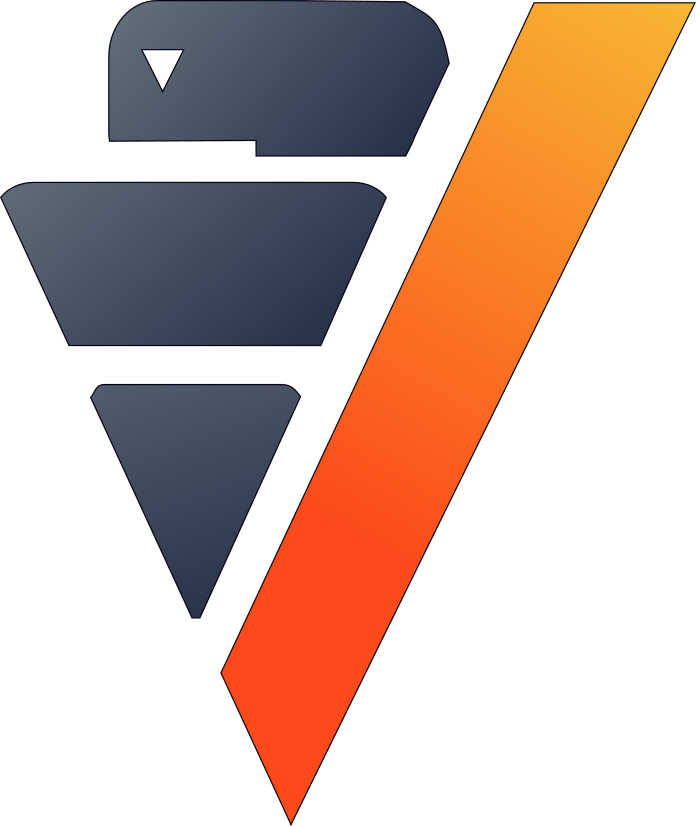

In [53]:
vp.drop("football_train", relation_type = "table")
all_matchs.to_db(name = "football_train",
                 relation_type = "table",
                 db_filter = (st.year(all_matchs["date"]) <= 2015) & 
                             (st.year(all_matchs["date"]) > 1980) &
                             (all_matchs["match_sample"] == 1))
vp.drop("football_test", relation_type = "table")
all_matchs.to_db(name = "football_test",
                 relation_type = "table",
                 db_filter = (st.year(all_matchs["date"]) > 2015) &
                             (all_matchs["match_sample"] == 1))

## Machine Learning

It's time to make predictions about the outcomes of games. We have a lot of variables, so we need trees deep enough to pick up the most important features. We also need to consider a minimum number of games in each leaf to avoid over-fitting. 

,1,2,X
auc,0.7532905686084831,0.7678233943620735,0.616591353614215
prc_auc,0.7362766557526347,0.5943283749282702,0.31077088659540575
accuracy,0.6830615465544451,0.7012098895318254,0.5381378221988428
log_loss,0.254380623861236,0.215458415754937,0.233647694000063
precision,0.6481572481572482,0.48242811501597443,0.2997624703087886
recall,0.7295353982300885,0.6984273820536541,0.6911281489594743
f1_score,0.6864428831641947,0.5706727135298564,0.4181577203445991
mcc,0.370937278683658,0.36732677231653355,0.15546104181681372
informedness,0.3704581665350033,0.4007427073017247,0.18091700323430993
markedness,0.37141701046624664,0.33669722543170977,0.13358686630171723

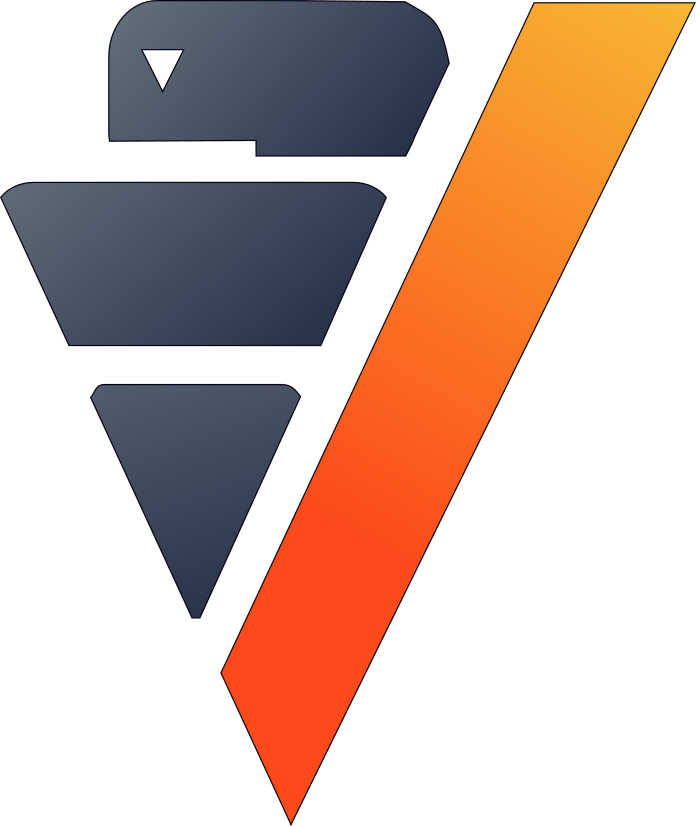

In [54]:
predictors = all_matchs.get_columns(exclude_columns = ["match_sample", 
                                                       "team2_score", 
                                                       "team1_score", 
                                                       "date",
                                                       "city",
                                                       "country",
                                                       "result",
                                                       "victory_team1",
                                                       "victory_team2",
                                                       "draw"])

from verticapy.learn.ensemble import RandomForestClassifier
model = RandomForestClassifier(name = "RF_football",
                               max_depth = 25,
                               n_estimators = 20,
                               sample = 0.7,
                               nbins = 50,
                               max_leaf_nodes = 11000,
                               min_samples_leaf = 3)
model.fit("football_train",
          predictors,
          "result",
          "football_test")
model.classification_report()

Our model is excellent! 57% of accuracy on 3 categories - it's almost twice as good as a random model.

In [55]:
model.score(method = "accuracy")

0.572593371909521

Looking at the importance of each feature, it seems like direct confrontations and victories against teams of another rank seem to be the strongest indicators of a team's success.

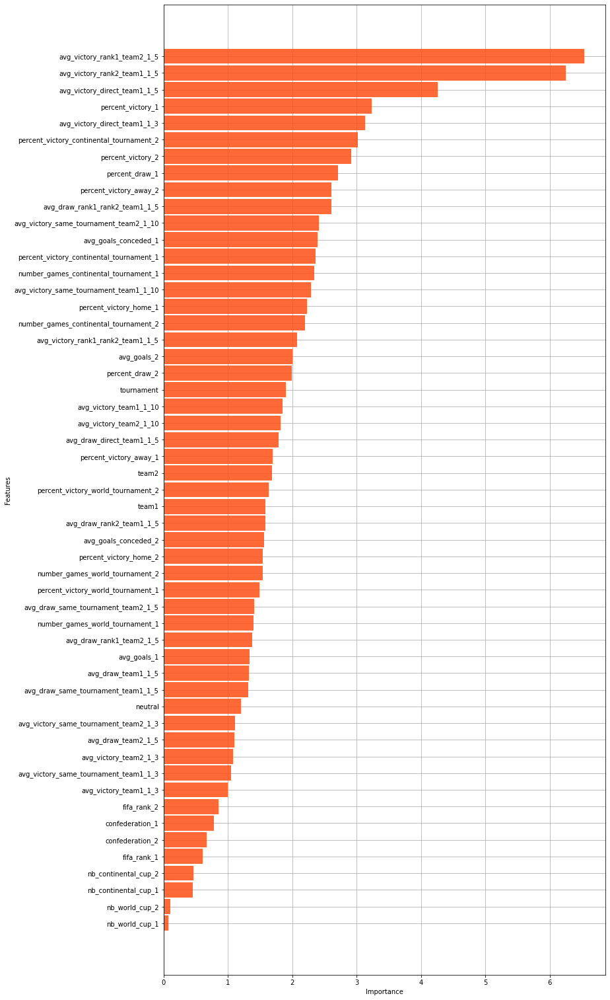

In [56]:
x = model.features_importance()

Let's add the predictions to the vDataFrame.

Draws are pretty rare, so we'll only consider them if a tie was very likely to occur.

,📅dateDate,AbcVarchar(84),123neutralInt,AbccountryVarchar(64),AbccityVarchar(56),Abcteam1Varchar(64),123team1_scoreInt,Abcteam2Varchar(64),123team2_scoreInt,123match_sampleInt,123nb_World_Cup_1Int,123fifa_rank_1Int,123Avg_goals_1Float,123Percent_Draw_1Float,"123Number_Games_World_Tournament_1Numeric(34,15)",123Float,123Percent_Victory_Away_1Float,123Float,Abcconfederation_1Varchar(8),123Percent_Victory_Home_1Float,123Avg_goals_conceded_1Float,"123Numeric(34,15)","123nb_Continental_Cup_1Numeric(34,15)",123Percent_Victory_1Float,123nb_World_Cup_2Int,...,123avg_victory_team1_1_3Float,123avg_draw_team1_1_5Float,123avg_victory_team2_1_10Float,123avg_victory_team2_1_3Float,123avg_draw_team2_1_5Float,123Float,123Float,123Float,123Float,123Float,123Float,123avg_victory_direct_team1_1_5Float,123avg_victory_direct_team1_1_3Float,123avg_draw_direct_team1_1_5Float,123avg_victory_rank2_team1_1_5Float,123avg_draw_rank2_team1_1_5Float,123avg_victory_rank1_team2_1_5Float,123avg_draw_rank1_team2_1_5Float,123Float,123avg_draw_rank1_rank2_team1_1_5Float,AbcresultVarchar(1),Abcprob_1Varchar(128),Abcprob_XVarchar(128),Abcprob_2Varchar(128),AbcpredictionVarchar(1)
1,2016-08-26,,0,England,London,Barawa,2,Chagos Islands,3,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0.0,0.0,0.0,0.0,0.0,,,,,,,1.0,1.0,0.0,[null],[null],[null],[null],,0.0,2,[null],[null],[null],[null]
2,2018-04-08,,0,England,London,Barawa,4,Chagos Islands,1,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0.0,0.0,0.5,0.5,0.0,,,,,,,0.0,0.0,0.0,0.0,0.0,1.0,0.0,,0.0,1,[null],[null],[null],[null]
3,2018-05-31,,1,England,Carshalton,United Koreans in Japan,0,Western Armenia,0,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0.0,0.4,0.0,0.0,0.333333333333333,,,,,,,0.4,0.4,0.2,[null],[null],[null],[null],,0.2,X,[null],[null],[null],[null]
4,2018-06-07,,0,England,Sutton,Barawa,0,Panjab,5,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0.666666666666667,0.0,0.25,0.0,0.25,,,,,,,0.5,0.5,0.0,0.5,0.0,[null],[null],,0.4,2,[null],[null],[null],[null]
5,2018-06-09,,0,England,Haringey,Barawa,0,Western Armenia,7,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],[null],...,0.333333333333333,0.0,0.0,0.0,0.5,,,,,,,0.333333333333333,0.333333333333333,0.0,0.333333333333333,0.0,0.0,1.0,,0.4,2,[null],[null],[null],[null]
6,2016-05-30,,1,Georgia,Suhkumi,United Koreans in Japan,1,Székely Land,0,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],0,...,[null],[null],0.0,0.0,0.0,,,,,,,0.0,0.0,0.0,[null],[null],[null],[null],,0.0,1,[null],[null],[null],[null]
7,2016-08-25,,0,England,London,Barawa,0,Tamil Eelam,5,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],0,...,[null],[null],0.166666666666667,0.0,0.0,,,,,,,0.25,0.25,0.25,[null],[null],[null],[null],,0.25,2,[null],[null],[null],[null]
8,2018-05-31,,0,England,Bromley,Barawa,4,Tamil Eelam,0,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],0,...,0.333333333333333,0.0,0.285714285714286,0.333333333333333,0.0,,,,,,,0.0,0.0,0.0,0.0,0.0,1.0,0.0,,0.2,1,[null],[null],[null],[null]
9,2018-06-03,,0,England,Rotherhithe,Barawa,2,Ellan Vannin,0,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],0,...,0.666666666666667,0.0,0.285714285714286,0.666666666666667,0.2,,,,,,,0.5,0.5,0.0,0.5,0.0,[null],[null],,0.2,1,[null],[null],[null],[null]
10,2018-06-05,,1,England,Bracknell,United Koreans in Japan,5,Tuvalu,0,1,[null],[null],[null],[null],[null],,[null],,[null],[null],[null],,[null],[null],0,...,0.0,0.6,0.1,0.333333333333333,0.0,,,,,,,1.0,1.0,0.0,1.0,0.0,[null],[null],,0.2,1,[null],[null],[null],[null]

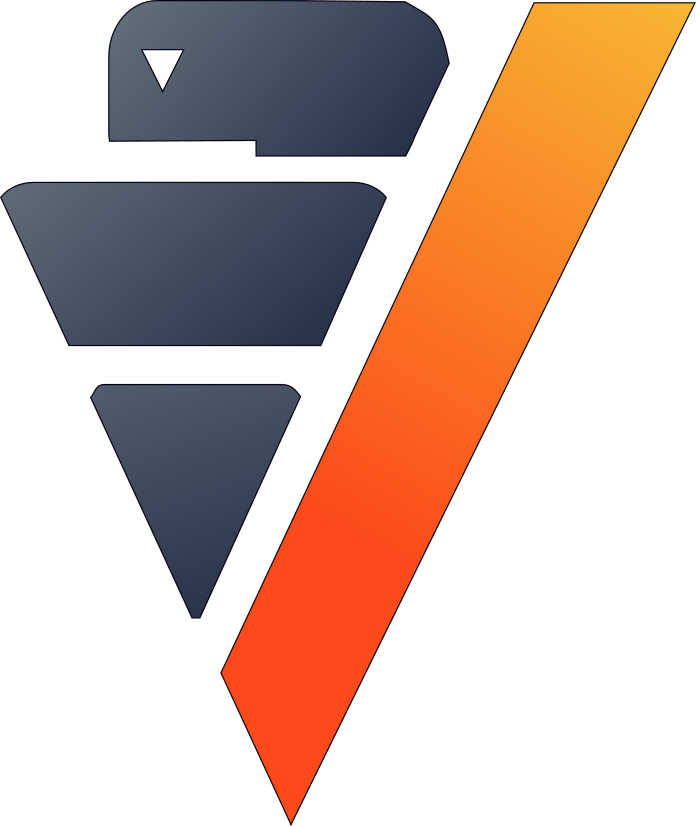

In [57]:
test = vp.vDataFrame("football_test")
model.predict_proba(test, name = "prob_1", pos_label = "1")
model.predict_proba(test, name = "prob_X", pos_label = "X")
model.predict_proba(test, name = "prob_2", pos_label = "2")
test.case_when("prediction",
               test["prob_1"] > test["prob_2"] + 0.05, "1",
               test["prob_2"] > test["prob_1"] + 0.05, "2",
               (test["prob_X"] > test["prob_1"]) & (test["prob_X"] > test["prob_2"]), "X",
               st.abs(test["prob_1"] - test["prob_2"]) < 0.03, "X",
               test["prob_1"] > test["prob_2"], "1",
               test["prob_1"] < test["prob_2"], "2")

Let's look at our predictions for the 2018 World Cup.

,📅dateDate,Abcteam1Varchar(64),AbcresultVarchar(1),AbcpredictionVarchar(1),Abcteam2Varchar(64),Abcprob_1Varchar(128),Abcprob_XVarchar(128),Abcprob_2Varchar(128)
1,2018-06-14,Russia,1,1,Saudi Arabia,0.615982,0.193977,0.190041
2,2018-06-15,Portugal,X,2,Spain,0.346045,0.269092,0.384863
3,2018-06-15,Egypt,2,2,Uruguay,0.279023,0.12121,0.599767
4,2018-06-15,Morocco,2,1,Iran,0.373753,0.334783,0.291464
5,2018-06-16,Peru,2,1,Denmark,0.41561,0.302877,0.281513
6,2018-06-16,France,1,1,Australia,0.500506,0.349001,0.150494
7,2018-06-16,Argentina,X,1,Iceland,0.673556,0.216347,0.110097
8,2018-06-16,Croatia,1,1,Nigeria,0.493254,0.196819,0.309927
9,2018-06-17,Germany,2,1,Mexico,0.446671,0.393852,0.159477
10,2018-06-17,Brazil,X,1,Switzerland,0.534365,0.25544,0.210195

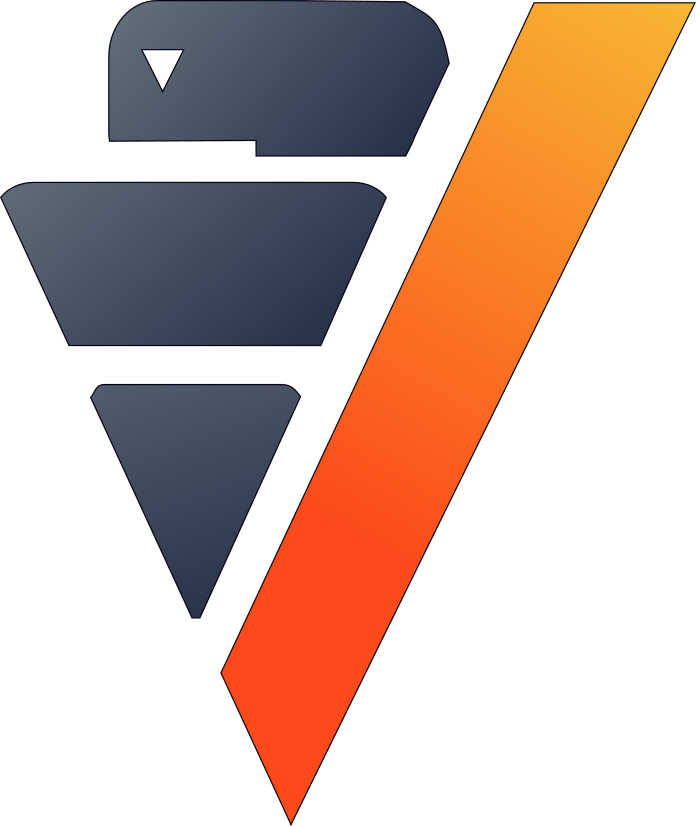

In [58]:
test.search(conditions = [test["tournament"] == 'FIFA World Cup'], 
            usecols = ["date",
                       "team1", 
                       "result", 
                       "prediction", 
                       "team2", 
                       "prob_1", 
                       "prob_X", 
                       "prob_2"],
            order_by = ["date"]).head(128)

Fantastic: we built a very efficient model which predicted that France will win almost all of its games (except the game against Argentina which is really hard to predict). In reality, France did indeed win the 2018 World Cup!

,📅dateDate,Abcteam1Varchar(64),AbcresultVarchar(1),AbcpredictionVarchar(1),Abcteam2Varchar(64),Abcprob_1Varchar(128),Abcprob_XVarchar(128),Abcprob_2Varchar(128)
1,2018-06-16,France,1,1,Australia,0.500506,0.349001,0.150494
2,2018-06-21,France,1,1,Peru,0.604562,0.2061,0.189338
3,2018-06-26,Denmark,X,2,France,0.316886,0.171057,0.512057
4,2018-06-30,France,1,2,Argentina,0.355175,0.257457,0.387368
5,2018-07-06,Uruguay,2,2,France,0.319222,0.24342,0.437357
6,2018-07-10,France,1,1,Belgium,0.536896,0.14514,0.317964
7,2018-07-15,France,1,1,Croatia,0.509816,0.234189,0.255995

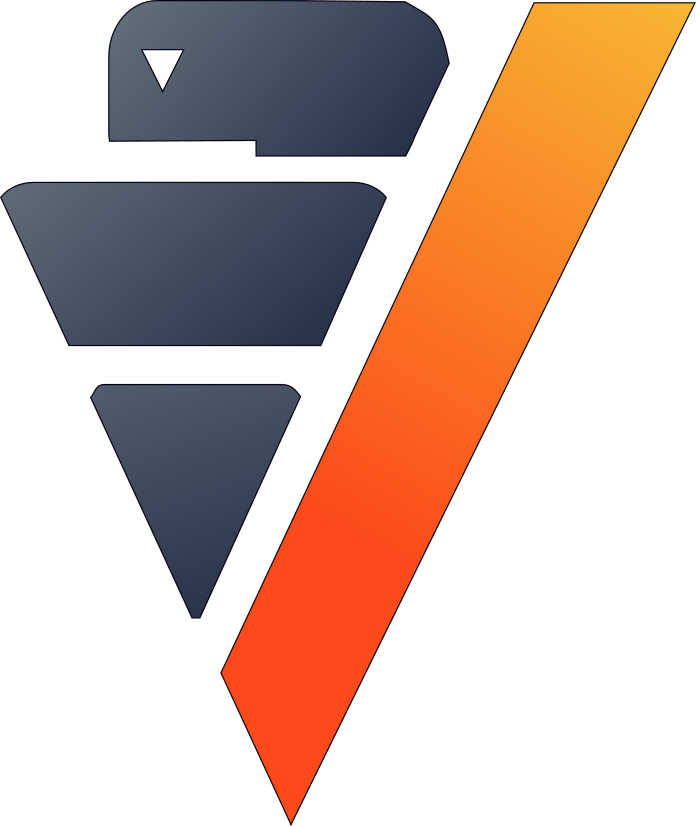

In [59]:
test.search(conditions = [test["tournament"] == 'FIFA World Cup',
                          (test["team1"] == 'France') | (test["team2"] == 'France')], 
            usecols = ["date",
                       "team1", 
                       "result", 
                       "prediction", 
                       "team2", 
                       "prob_1", 
                       "prob_X", 
                       "prob_2"],
            order_by = ["date"]).head(128)

## Conclusion

We've solved our problem in a Pandas-like way, all without ever loading data into memory!